In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import matplotlib.patches as patches
import matplotlib.gridspec as gridspec
import time
from tensorflow.python.layers.base import Layer

/opt/conda/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)
/opt/conda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
def make_toy_dataset_old(num_samples,noise):
    cir_sample=num_samples*2//3
    circle_circ_x = np.cos(np.linspace(0, np.pi, cir_sample))
    circle_circ_y = np.sin(np.linspace(0, np.pi, cir_sample))
    norm_sample=num_samples-cir_sample
    norm_circ_x = np.zeros(norm_sample)
    norm_circ_y = np.zeros(norm_sample)
    X=np.vstack((np.append(circle_circ_x,norm_circ_x),np.append(circle_circ_y,norm_circ_y))).T
    X += np.random.randn(X.shape[0],X.shape[1])*noise
    index=np.arange(num_samples)
    np.random.shuffle(index)
    return X[index,:]

def make_toy_dataset(num_samples,noise):
    circle_circ_x = np.cos(np.linspace(0, np.pi, num_samples))
    circle_circ_y = np.sin(np.linspace(0, np.pi, num_samples))
    X=np.vstack((circle_circ_x,circle_circ_y)).T
    X += np.random.randn(X.shape[0],X.shape[1])*noise
    index=np.arange(num_samples)
    np.random.shuffle(index)
    return X[index,:]

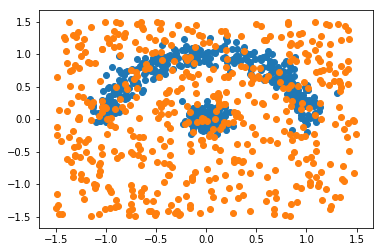

In [3]:
X_true=make_toy_dataset_old(500,0.1)
X_fake=np.random.uniform(low=-1.5,high=1.5,size=(500,2))
plt.scatter(X_true[:,0],X_true[:,1])
plt.scatter(X_fake[:,0],X_fake[:,1])
plt.show()

In [4]:
'''
**************************************************************************************************************
Problem: this model try to predict everything sample as positive to minimize loss
potential solution: saparate into two step: first freeze VAE, optimize classifier. Then optimize VAE
plan B: train a global classifier to classify true sample and uniform random noise(cover all true sample),
then freeze classifier, increase score of VAE output
**************************************************************************************************************
'''

tf.reset_default_graph()
X=tf.placeholder(dtype=tf.float32,shape=[None,2])
y=tf.placeholder(dtype=tf.int32,shape=[None])

mask_psed_neg=tf.reshape(tf.cast(tf.equal(y,1),tf.float32),(-1,1))
mask_not_psed_neg=tf.reshape(tf.cast(tf.logical_not(tf.equal(y,1)),tf.float32),(-1,1))

y_onehot=tf.one_hot(y,3)
eps=1e-10

class Classifier(Layer):
    def __init__(self):
        self.linear1=tf.layers.Dense(units=256,name='linear1',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear2=tf.layers.Dense(units=256,name='linear2',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear3=tf.layers.Dense(units=256,name='linear3',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear4=tf.layers.Dense(units=3,name='linear4',_reuse=tf.AUTO_REUSE)
    
    def __call__(self,inputs):
        score=self.linear4(self.linear3(self.linear2(self.linear1(inputs))))
        return score
    
class VAE(Layer):
    def __init__(self):
        self.lstm_hidden_dim=20
        self.latent_dim=10
        self.n_time=4
        self.encoder_lstm=tf.contrib.rnn.LSTMCell(self.lstm_hidden_dim)
        self.decoder_lstm=tf.contrib.rnn.LSTMCell(self.lstm_hidden_dim)
        self.encode_mean=tf.layers.Dense(units=self.latent_dim,name='encode_mean')   # calculate mean of z
        self.encode_std=tf.layers.Dense(units=self.latent_dim,name='encode_std')   # calculate std of z
        self.unit_gaussian=tf.distributions.Normal(loc=tf.zeros(self.latent_dim),scale=tf.ones(self.latent_dim))
        self.emit_net=tf.layers.Dense(units=2,name='emit_net')
        
    def __call__(self,inputs):
        batch_size=tf.shape(inputs)[0]
        state_encode=self.encoder_lstm.zero_state(batch_size, tf.float32)   # lstm tuple (c,h)
        state_decode=self.decoder_lstm.zero_state(batch_size, tf.float32)   # lstm tuple (c,h)
        original_image=tf.layers.flatten(inputs)
        output_image=None
        latent_loss_his=[]
        classifier_loss_his=[]
        likelihood_his=[]
        predict_his=[]
        image_his=[]
        
        for t in range(self.n_time):
            if t==0:
                image=original_image
            else:
                # use output_image for fake images, use original image for real image
                image=mask_psed_neg*output_image+mask_not_psed_neg*original_image
            image_his.append(image)
            '''
            Part I: Classifier
            **************************************************************************************************************
            There is a problem with classifier. 
            During classifing, we only want to train the variables in the classifiers.  (solved)
            During likelihood estimation, we do not want to change the variables in the classifiers. (unsolved)
            **************************************************************************************************************
            '''
            classifier_scope="CNN_classifier_"+str(t)
            input_image=tf.reshape(image,(-1,2))
            with tf.variable_scope(classifier_scope) as vs:
                classifier=Classifier()
                score_likelihood=classifier(input_image)
            with tf.variable_scope(classifier_scope) as vs:
                classifier=Classifier()
                score_classifier=classifier(tf.stop_gradient(input_image))
            
            score_likelihood=tf.reshape(score_likelihood[:,0]-score_likelihood[:,1],(-1,1))*mask_psed_neg
            likelihood_his.append(score_likelihood) # only record score for fake images
            classifier_loss_his.append(tf.losses.softmax_cross_entropy(logits=score_classifier,onehot_labels=y_onehot))
            predict_his.append(score_classifier)
            
            '''
            Part II: Recurrent VAE
            '''
            with tf.variable_scope("LSTM_encoder") as vs:
                encode_out,state_encode=self.encoder_lstm(image,state_encode)
            z_mean=self.encode_mean(encode_out)
            z_std=tf.exp(self.encode_std(encode_out))
            distrib_encode=tf.distributions.Normal(loc=z_mean,scale=z_std)
            Z=distrib_encode.sample()
            
            latent_loss=tf.reduce_sum(mask_psed_neg*tf.distributions.kl_divergence(distrib_encode,self.unit_gaussian),axis=1)
            latent_loss_his.append(latent_loss)
            
            with tf.variable_scope("LSTM_decoder") as vs:
                decode_out,state_decode=self.decoder_lstm(Z,state_decode)
                
            output_image=self.emit_net(decode_out)
            
        tot_latent_loss=tf.reduce_mean(latent_loss_his)
        tot_classifier_loss=tf.reduce_mean(classifier_loss_his)
        tot_likelihood_loss=tf.reduce_sum(likelihood_his,axis=0)  # accumulate score through time
#         tot_likelihood_loss=tf.reduce_mean(-tf.nn.sigmoid(tot_likelihood_loss))
        tot_likelihood_loss=tf.reduce_mean(-tot_likelihood_loss)
        
        tot_loss=tot_latent_loss+tot_classifier_loss+tot_likelihood_loss
            
        return image_his,tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,predict_his


vae=VAE()
image_his,tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,predict_his=vae(X)
tot_classifier_loss=tot_classifier_loss
tot_loss2=tot_latent_loss+tot_likelihood_loss

optimizier=tf.train.AdamOptimizer(learning_rate=1e-2)
train_step1 = optimizier.minimize(tot_classifier_loss)
train_step2 = optimizier.minimize(tot_loss2)

In [5]:
vv0=[v for v in tf.global_variables() if v.name=='CNN_classifier_0/linear1/kernel:0'][0]
vv1=[v for v in tf.global_variables() if v.name=='CNN_classifier_1/linear1/kernel:0'][0]
vv2=[v for v in tf.global_variables() if v.name=='CNN_classifier_2/linear1/kernel:0'][0]
vv3=[v for v in tf.global_variables() if v.name=='CNN_classifier_3/linear1/kernel:0'][0]

new_score=[]

for t in range(4):
    with tf.variable_scope("CNN_classifier_"+str(t)) as vs:
        classifier=Classifier()
        n_score=classifier(X)
        new_score.append(n_score)

In [6]:
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    X_true=make_toy_dataset_old(200,0.1)
    X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
    X_noise=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
    image=np.vstack((X_true,X_fake,X_noise))
    label=np.concatenate((np.zeros(200),np.ones(200),2*np.ones(200)))
    a=sess.run(predict_his,feed_dict={X:image,y:label})
    b=sess.run(new_score,feed_dict={X:image,y:label})

In [7]:
# for v in tf.global_variables():
#     print(v)

In [8]:
# vv=[v for v in tf.global_variables() if v.name=='CNN_classifier_0/linear1/kernel:0'][0]
# vv2=[v for v in tf.global_variables() if v.name=='CNN_classifier_1/linear1/kernel:0'][0]
# vv3=[v for v in tf.global_variables() if v.name=='encode_mean/kernel:0'][0]
# a=tf.gradients(tot_loss,vv)[0]
# b=tf.gradients(tot_latent_loss,vv)[0]
# c=tf.gradients(tot_classifier_loss,vv)[0]
# d=tf.gradients(tot_likelihood_loss,vv)[0]
# print(a)
# print(b)
# print(c)
# print(d)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
#     original0=sess.run(vv)
#     original1=sess.run(vv2)
#     X_true=make_toy_dataset(200,0.1)
#     X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
#     image=np.vstack((X_true,X_fake))
#     label=np.concatenate((np.ones(200),np.zeros(200)))
#     ga=sess.run(a,feed_dict={X:image,y:label})
#     gc=sess.run(c,feed_dict={X:image,y:label})
#     gd=sess.run(d,feed_dict={X:image,y:label})
#     _=sess.run(train_step,feed_dict={X:image,y:label})
#     latter0=sess.run(vv)
#     latter1=sess.run(vv2)
# #     print(original0-latter0)
# #     print(original1-latter1)

In [9]:
# out1=tf.layers.dense(X,units=20,activation=tf.nn.relu)
# score=tf.layers.dense(out1,units=1)
# prob=tf.nn.sigmoid(score)
# predict=tf.cast(prob>0.5,tf.int32)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
#     X_true=make_toy_dataset(200,0.1)
#     X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
#     image=np.vstack((X_true,X_fake))
#     label=np.concatenate((np.ones(200),np.zeros(200)))
#     p=sess.run(predict,feed_dict={X:image,y:label})
#     print(p.reshape(-1,))
    

In [10]:
def display(i_his,image_id): 
    plt.figure(1)
    h=0.1
    xx, yy = np.meshgrid(
        np.arange(-1.5, 1.5, h),
        np.arange(-1.5, 1.5, h))
    points=np.c_[xx.ravel(), yy.ravel()]
    p_his=sess.run(new_score,feed_dict={X:points,y:np.zeros(points.shape[0])})
    for t in range(4):
        plt.subplot(2,2,t+1)
        Z=np.argmax(p_his[t],axis=1)
        Z=Z.reshape(xx.shape)
#         print('t =',t,Z)
        _=plt.contourf(xx,yy,Z,cmap=plt.cm.coolwarm_r, alpha=0.8)
        plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
        plt.scatter(i_his[t][200:400,0],i_his[t][200:400,1])
#         plt.scatter(i_his[t][400:,0],i_his[t][400:,1])
        plt.axis('off')
        plt.colorbar(_)
#     plt.savefig('fig/toy_dataset_'+str(image_id)+'.png')
    plt.show()

iteration  0
1.0893759 0.004566748 1.1004899 -0.015680818


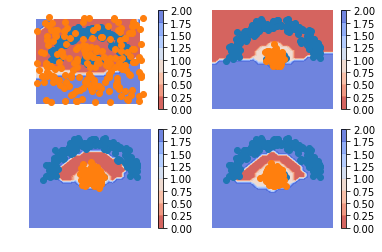

iteration  1
2.5415497 0.0044971793 0.73336643 1.8036861


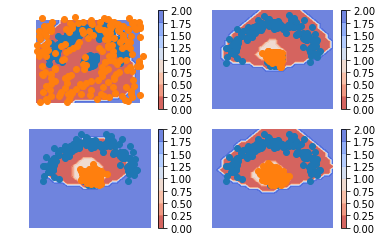

iteration  2
0.7004838 0.0036297394 0.74170375 -0.04484969


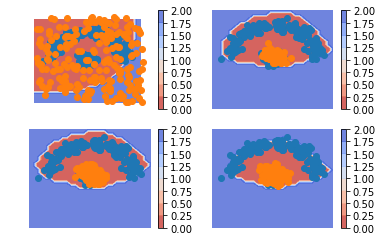

iteration  3
0.28651074 0.0030736534 0.7664209 -0.4829838


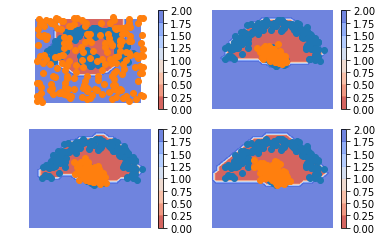

iteration  4
0.38337296 0.0026033528 0.79070973 -0.40994012


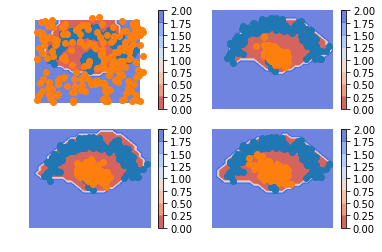

iteration  5
0.24651185 0.0025307743 0.73824716 -0.49426606


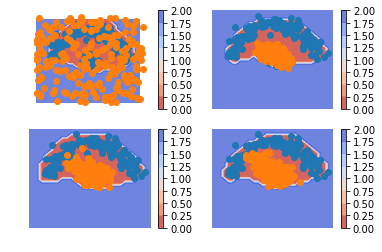

iteration  6
0.33450332 0.0031385918 0.76626253 -0.4348978


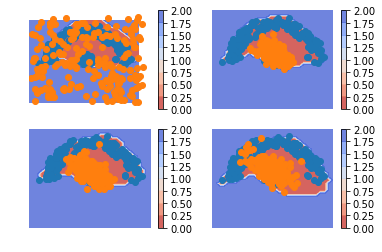

iteration  7
0.2327128 0.0061906753 0.8293507 -0.60282856


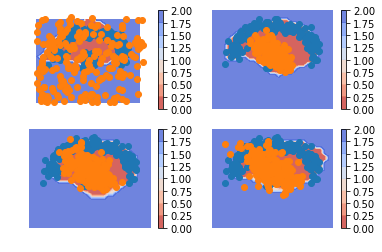

iteration  8
0.28192246 0.011048736 0.8995253 -0.62865156


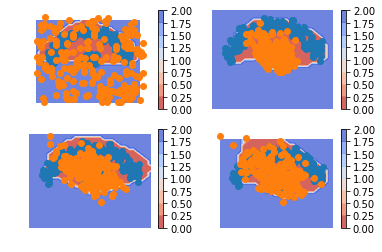

iteration  9
0.37270916 0.01641833 0.8427379 -0.4864471


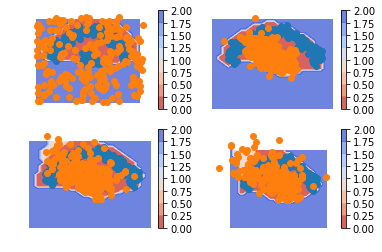

iteration  10
0.1621095 0.0131309545 0.86969674 -0.7207182


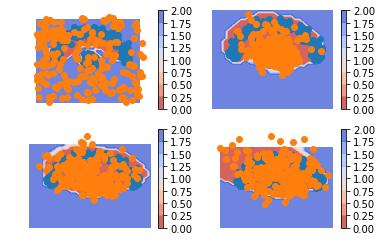

iteration  11
0.31640375 0.009380038 0.8410463 -0.53402257


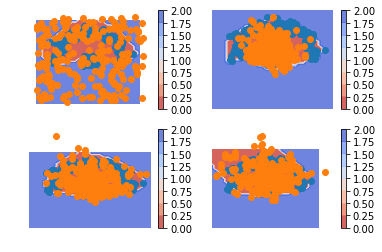

iteration  12
0.19389373 0.0068343864 0.83206916 -0.6450098


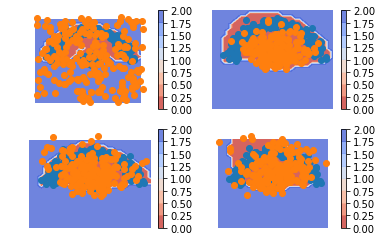

iteration  13
0.18043339 0.0059459875 0.8415644 -0.667077


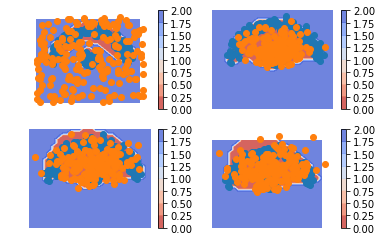

iteration  14
0.13280332 0.0053334394 0.8314891 -0.7040192


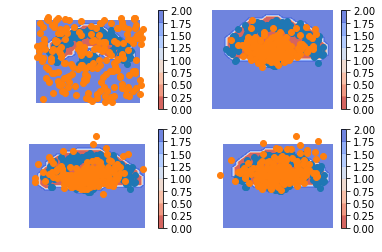

iteration  15
0.15265983 0.005315591 0.8161524 -0.66880816


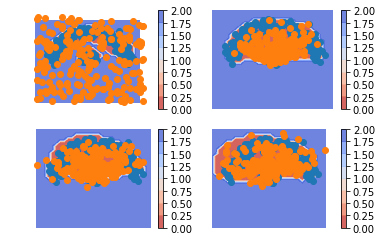

iteration  16
0.09689289 0.005461556 0.8374791 -0.7460478


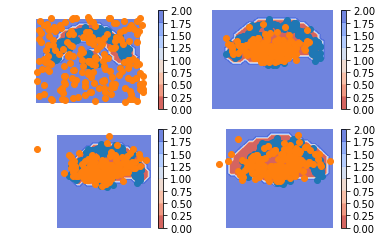

iteration  17
0.13865697 0.004984414 0.78602684 -0.6523543


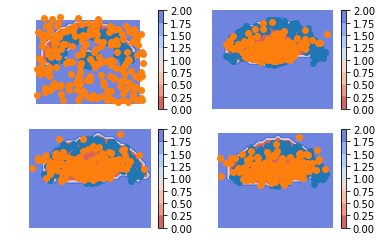

iteration  18
0.06222874 0.0053418237 0.78968793 -0.732801


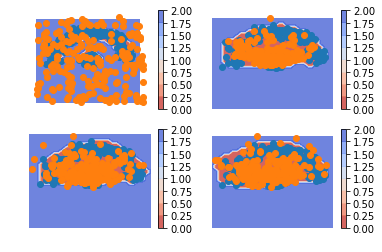

iteration  19
0.186719 0.006199045 0.8202325 -0.6397126


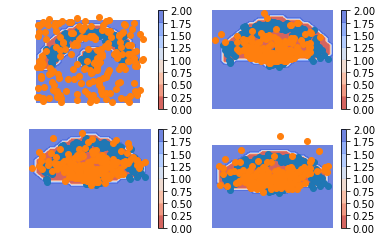

iteration  20
0.12576628 0.007140549 0.81631625 -0.69769055


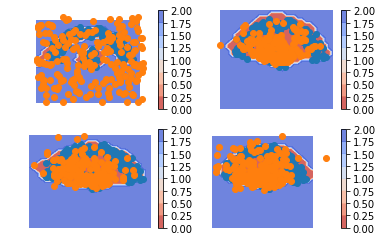

iteration  21
0.2583611 0.008524598 0.8245798 -0.5747433


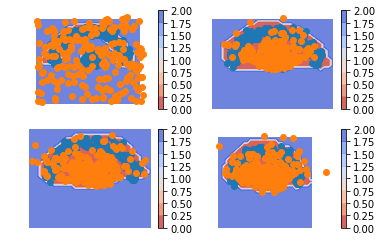

iteration  22
0.19664234 0.0069746226 0.8197941 -0.6301264


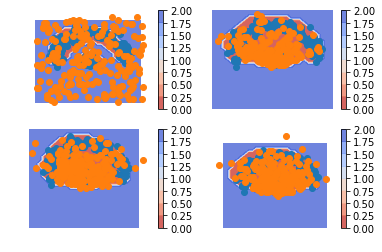

iteration  23
0.27945042 0.005805116 0.81876695 -0.54512167


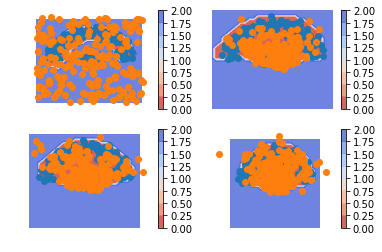

iteration  24
0.19708478 0.0044358363 0.8426351 -0.64998615


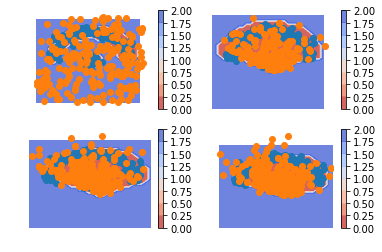

iteration  25
0.2475704 0.0038625384 0.8282625 -0.5845547


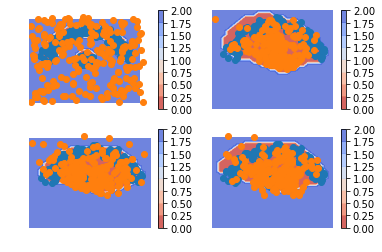

iteration  26
0.27814513 0.004453242 0.85239476 -0.57870287


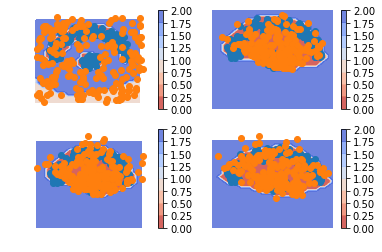

iteration  27
0.16515517 0.0052599395 0.78699803 -0.6271028


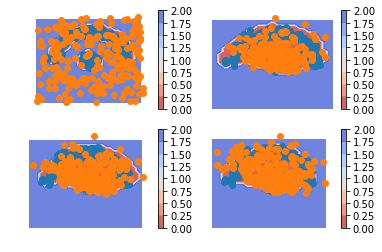

iteration  28
0.20913231 0.0061658286 0.821791 -0.6188245


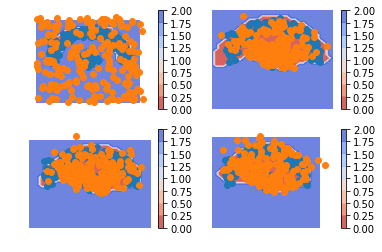

iteration  29
0.21417904 0.005838895 0.8128805 -0.60454035


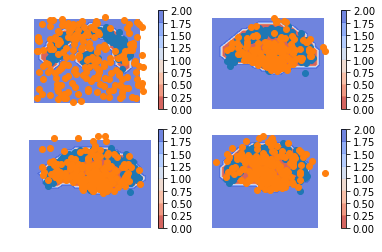

iteration  30
0.16933167 0.005795506 0.8142625 -0.6507263


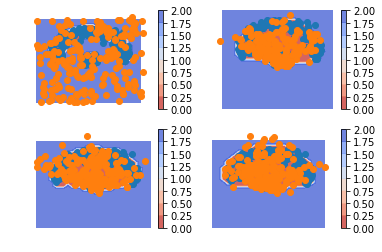

iteration  31
0.25098872 0.006061964 0.7917161 -0.54678935


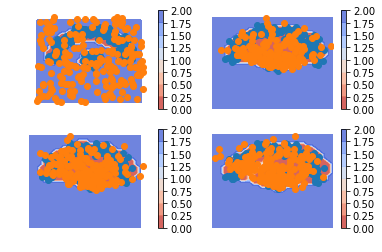

iteration  32
0.18137419 0.0061915116 0.79772455 -0.62254184


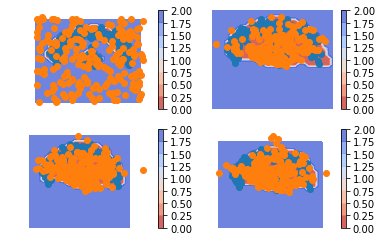

iteration  33
0.27686 0.0053518834 0.84287274 -0.57136464


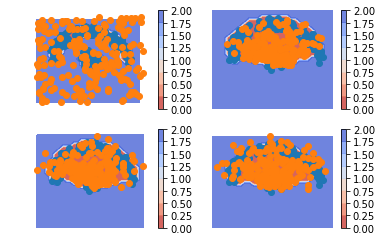

iteration  34
0.22733265 0.0044381525 0.81799066 -0.5950962


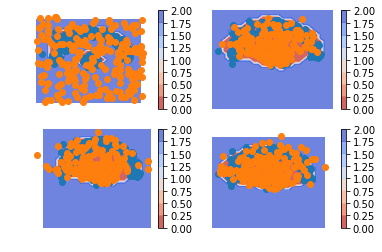

iteration  35
0.16455519 0.003508488 0.76816046 -0.6071138


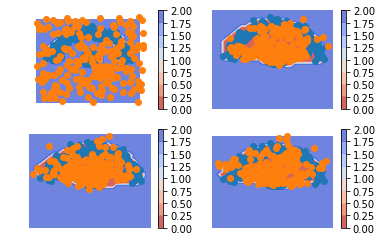

iteration  36
0.18234247 0.0032974405 0.8128862 -0.63384116


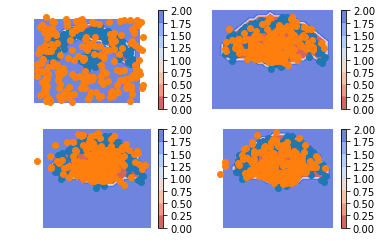

iteration  37
0.23654622 0.003187512 0.8075948 -0.5742361


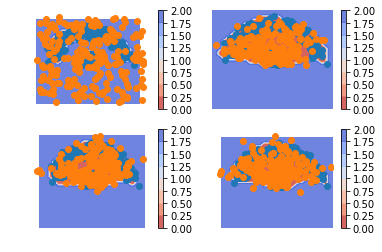

iteration  38
0.18911445 0.0035824697 0.793056 -0.60752404


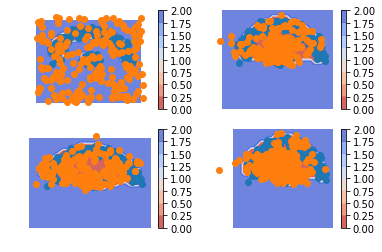

iteration  39
0.24996251 0.004897019 0.81561124 -0.57054573


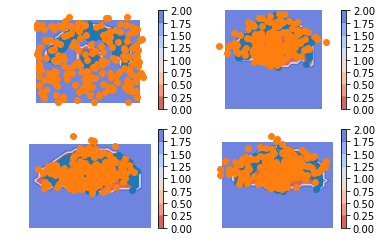

iteration  40
0.23167503 0.0055455803 0.82382965 -0.5977002


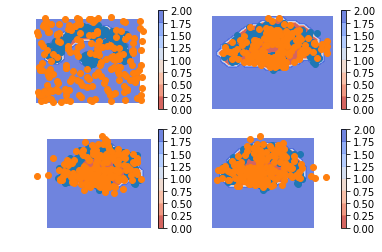

iteration  41
0.1965335 0.005806721 0.8115239 -0.62079716


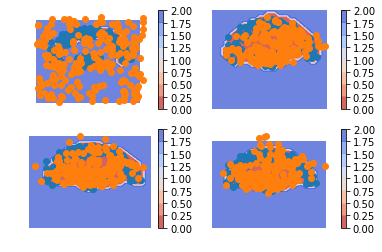

iteration  42
0.21476024 0.006014343 0.79061365 -0.58186775


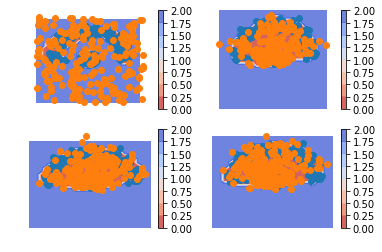

iteration  43
0.11048937 0.006503906 0.81036484 -0.70637935


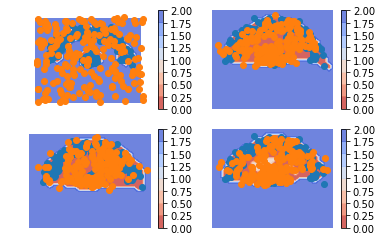

iteration  44
0.18373883 0.0071645817 0.80708885 -0.6305146


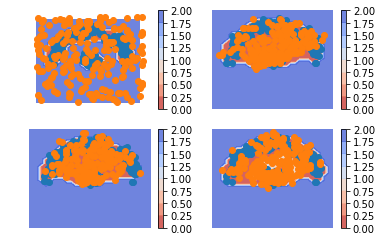

iteration  45
0.18722802 0.0074567357 0.78236794 -0.60259664


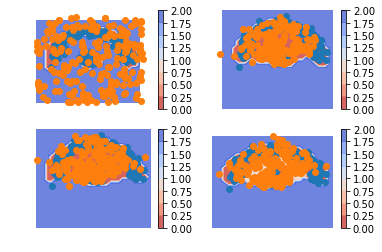

iteration  46
0.15117717 0.0071363146 0.8112627 -0.66722184


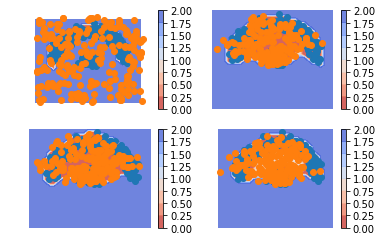

iteration  47
0.19479138 0.007350708 0.808669 -0.6212283


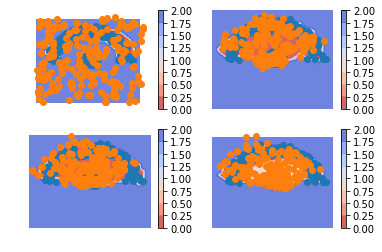

iteration  48
0.24559933 0.0071457746 0.80061734 -0.5621638


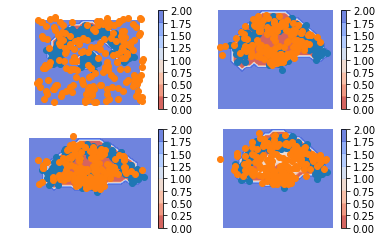

iteration  49
0.22012424 0.006372409 0.8281164 -0.61436456


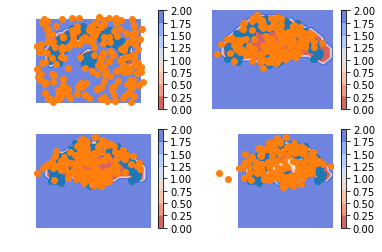

iteration  50
0.19970274 0.0057316516 0.7757547 -0.5817836


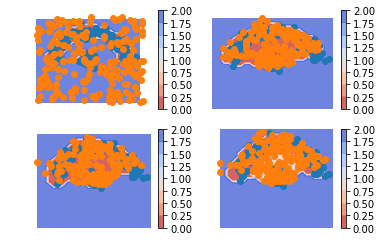

iteration  51
0.13600582 0.0050867232 0.81457084 -0.68365175


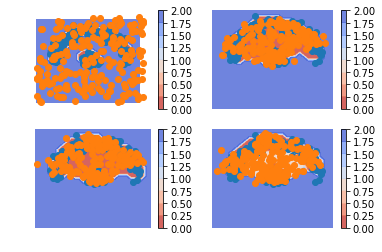

iteration  52
0.11204344 0.004639809 0.7916764 -0.68427277


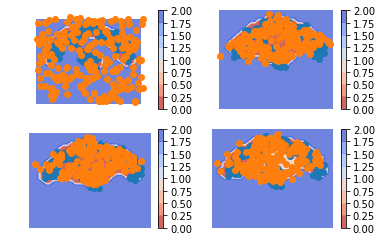

iteration  53
0.112561345 0.0048905257 0.80610275 -0.6984319


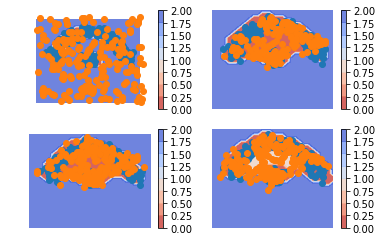

iteration  54
0.19990265 0.0042858347 0.81116176 -0.6155449


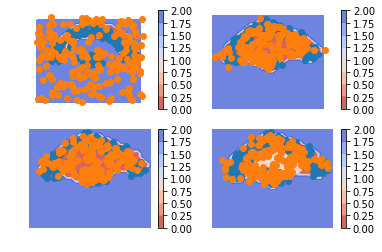

iteration  55
0.12371546 0.004178261 0.79593414 -0.67639697


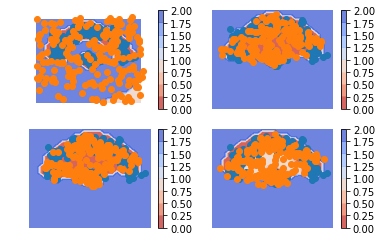

iteration  56
0.22157419 0.0041196696 0.80012405 -0.58266956


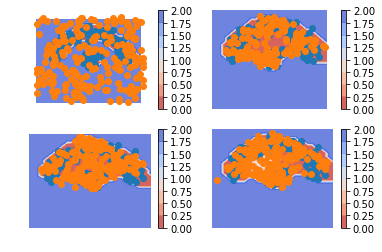

iteration  57
0.1449858 0.003844927 0.84239566 -0.7012548


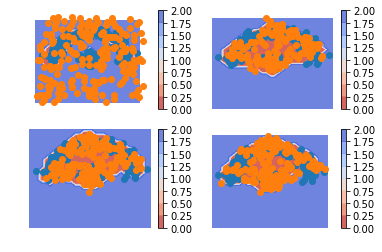

iteration  58
0.18107992 0.003565149 0.8138404 -0.6363256


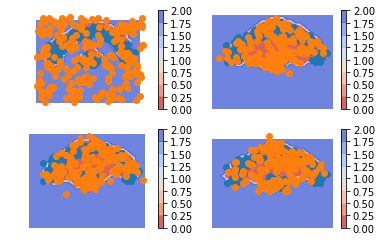

iteration  59
0.0805766 0.0036141705 0.8128989 -0.73593646


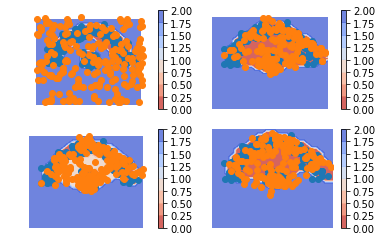

iteration  60
0.17673916 0.0030065768 0.8349242 -0.66119164


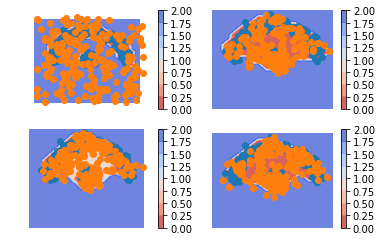

iteration  61
0.12329143 0.0026666033 0.83001375 -0.7093889


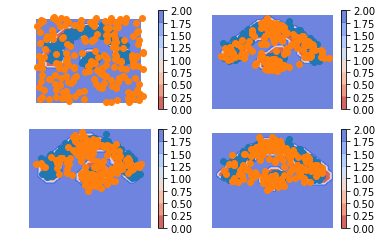

iteration  62
0.11526179 0.0031256722 0.8313056 -0.7191695


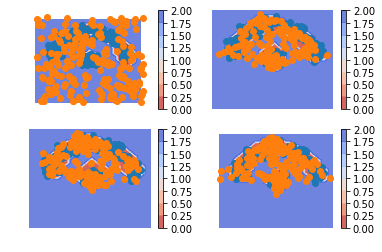

iteration  63
0.09321934 0.004088563 0.8339429 -0.74481213


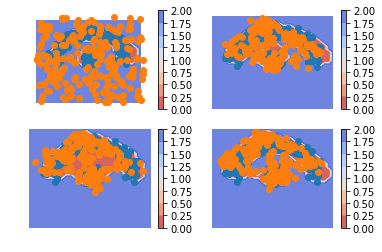

iteration  64
0.18275398 0.00480407 0.80402046 -0.62607056


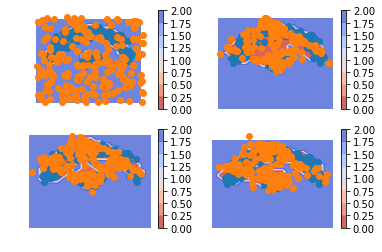

iteration  65
0.06113541 0.0048370864 0.78213114 -0.7258328


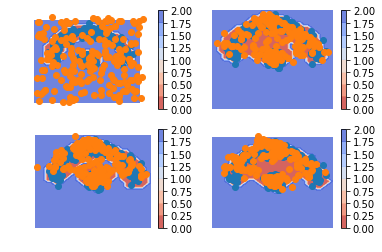

iteration  66
0.028951168 0.004651563 0.80753404 -0.7832344


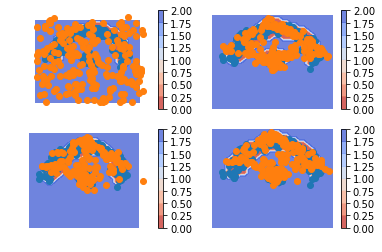

iteration  67
0.19261235 0.004393414 0.822718 -0.6344991


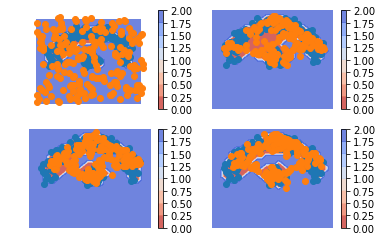

iteration  68
0.07324898 0.0038820577 0.79460937 -0.72524244


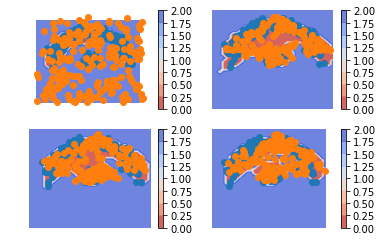

iteration  69
0.046420097 0.0031359552 0.7640241 -0.72073996


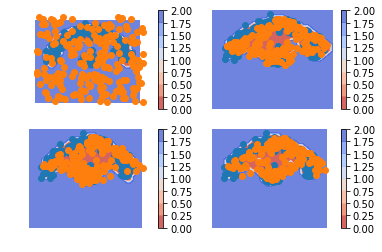

iteration  70
0.04557246 0.002563246 0.8205942 -0.77758497


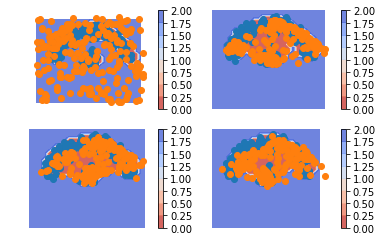

iteration  71
0.10836351 0.0022319283 0.81583893 -0.7097074


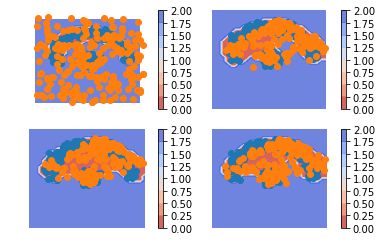

iteration  72
0.14653999 0.0022733577 0.83316433 -0.6888977


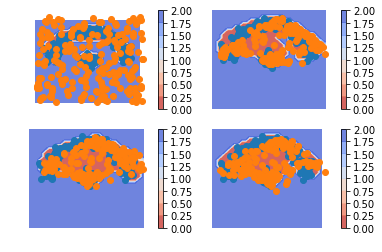

iteration  73
0.12168068 0.0026572675 0.7997258 -0.6807024


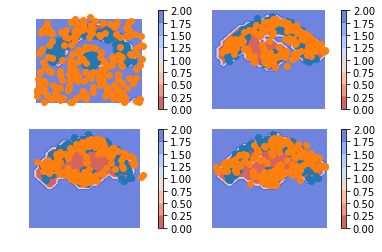

iteration  74
0.103485465 0.003154004 0.78607154 -0.68574005


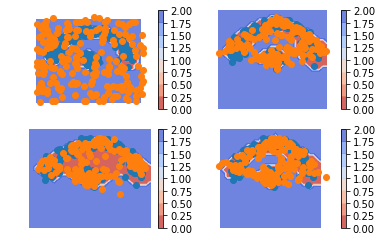

iteration  75
0.08106524 0.0042111995 0.86512804 -0.788274


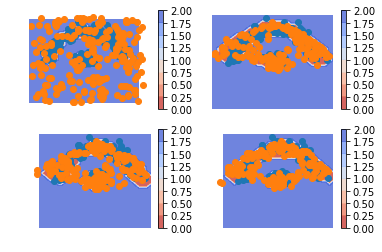

iteration  76
0.23841763 0.0053026453 0.8492307 -0.61611575


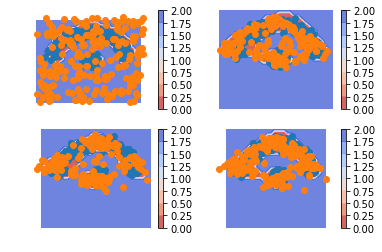

iteration  77
0.1516794 0.006270071 0.80568373 -0.6602744


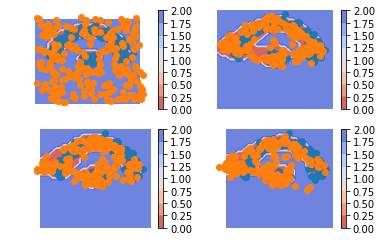

iteration  78
0.09022331 0.0064742984 0.81964076 -0.73589176


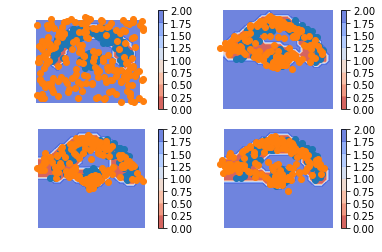

iteration  79
0.054316163 0.0061661247 0.85247487 -0.8043248


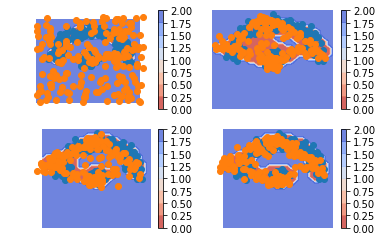

iteration  80
0.19792414 0.005456167 0.84047115 -0.64800316


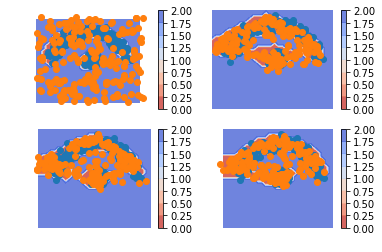

iteration  81
0.06321907 0.0048887646 0.807015 -0.7486847


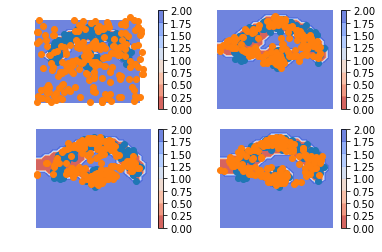

iteration  82
-0.015782416 0.0045017945 0.8213662 -0.8416504


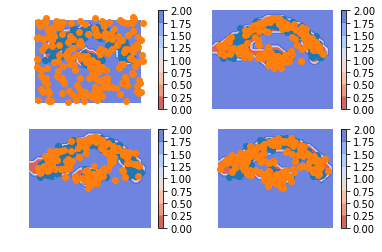

iteration  83
0.071897864 0.0042121927 0.82055366 -0.752868


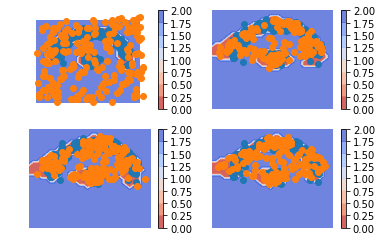

iteration  84
0.112947345 0.003885206 0.82955 -0.7204879


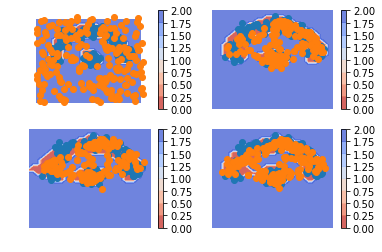

iteration  85
0.09963322 0.003418327 0.81613994 -0.71992505


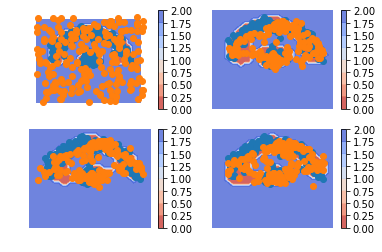

iteration  86
0.025595367 0.0030910398 0.7659117 -0.74340737


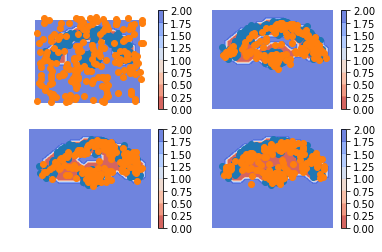

iteration  87
-0.02001077 0.003171194 0.8076103 -0.83079225


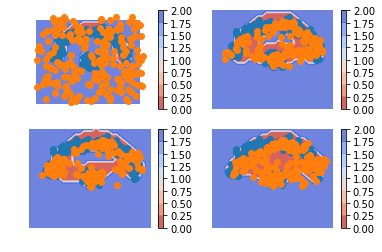

iteration  88
0.09183258 0.003702054 0.82019365 -0.7320631


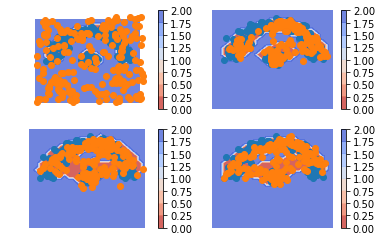

iteration  89
-0.019719481 0.004070463 0.7916552 -0.8154451


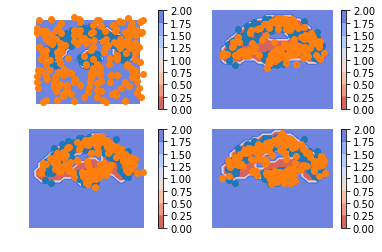

iteration  90
0.040359914 0.0044701463 0.8367692 -0.8008795


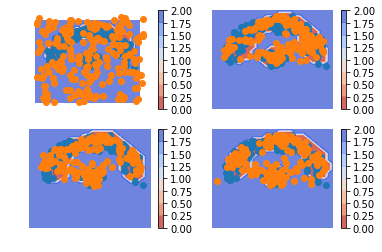

iteration  91
0.11582214 0.004975332 0.8344573 -0.72361046


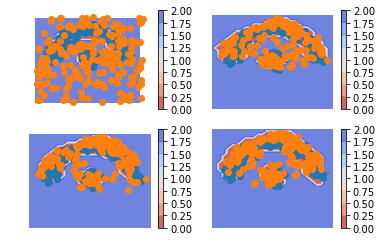

iteration  92
0.17320174 0.0051683765 0.8297035 -0.66167015


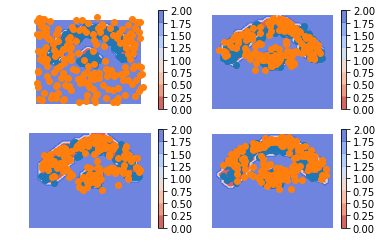

iteration  93
0.08600795 0.0047766254 0.8158972 -0.7346659


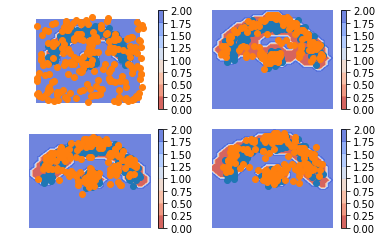

iteration  94
0.08830881 0.0043048207 0.81725 -0.733246


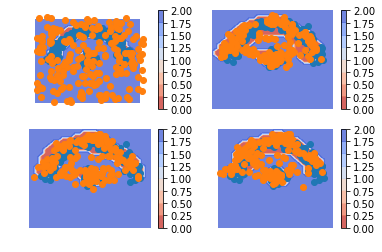

iteration  95
0.10334116 0.0035231297 0.8368895 -0.73707145


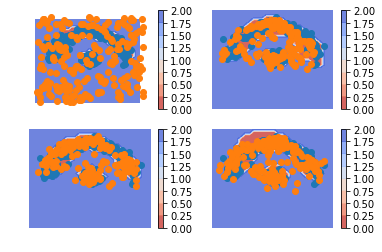

iteration  96
0.12717181 0.0029793482 0.8451723 -0.7209798


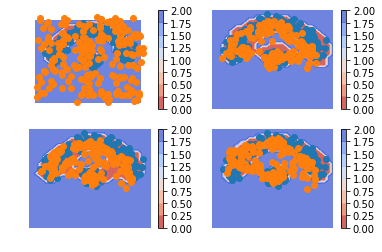

iteration  97
0.20683908 0.002558822 0.82089555 -0.6166153


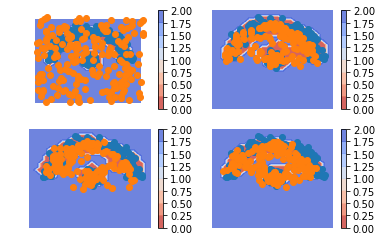

iteration  98
0.027793229 0.002177638 0.7979159 -0.7723003


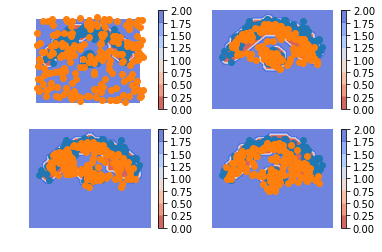

iteration  99
-0.09488982 0.0018555614 0.8148019 -0.91154724


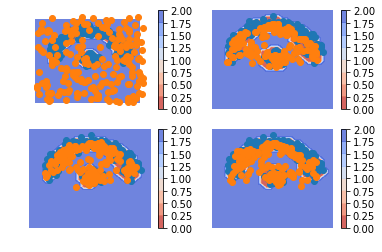

iteration  100
-0.052792132 0.0016153799 0.7750327 -0.82944024


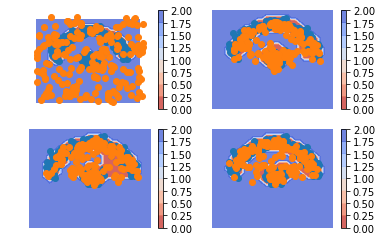

iteration  101
-0.05112058 0.0014845418 0.7675686 -0.8201737


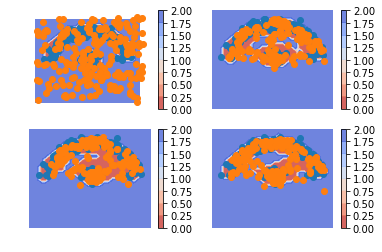

iteration  102
0.02127248 0.0014078901 0.85414964 -0.834285


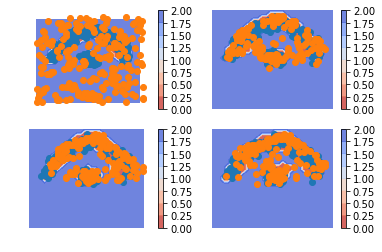

iteration  103
0.15516561 0.0015005799 0.8599597 -0.7062947


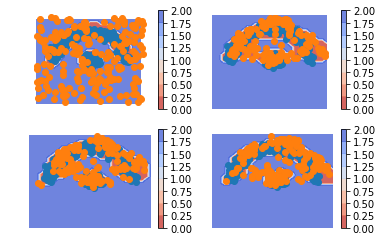

iteration  104
0.14364403 0.0016540713 0.85128164 -0.7092917


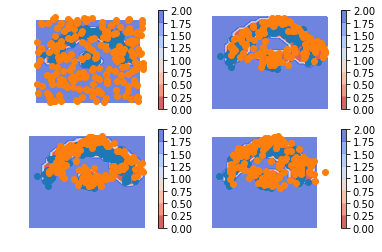

iteration  105
0.19898999 0.0019776477 0.7910062 -0.59399384


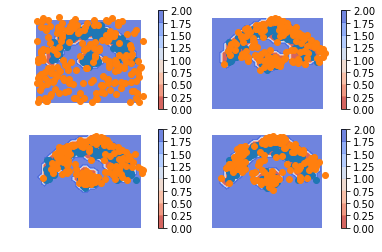

iteration  106
0.040434837 0.0026431778 0.8131586 -0.7753669


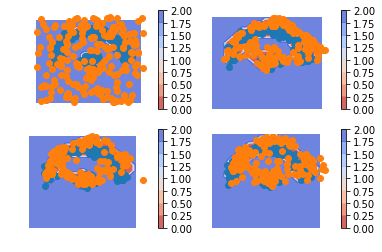

iteration  107
0.11907095 0.004079125 0.7792794 -0.66428757


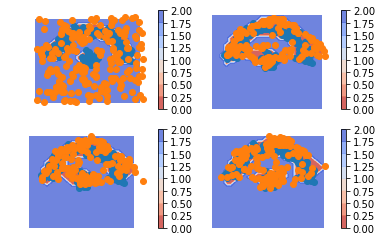

iteration  108
0.12064427 0.0063776462 0.84417856 -0.7299119


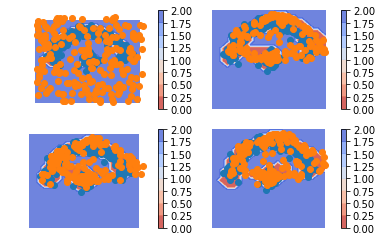

iteration  109
0.06299305 0.009730347 0.8235856 -0.7703229


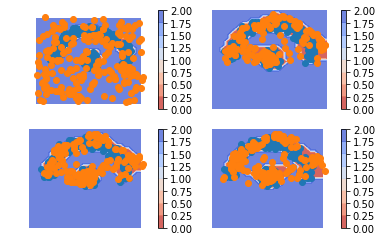

iteration  110
0.06739128 0.01457095 0.81487846 -0.76205814


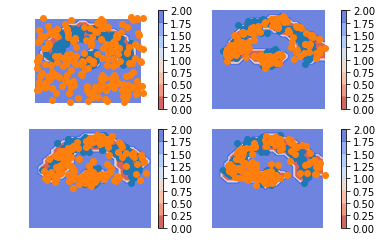

iteration  111
0.072674036 0.019797165 0.8095108 -0.75663394


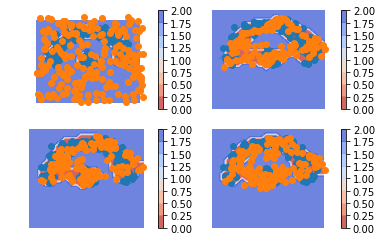

iteration  112
0.109090805 0.024911033 0.832481 -0.74830127


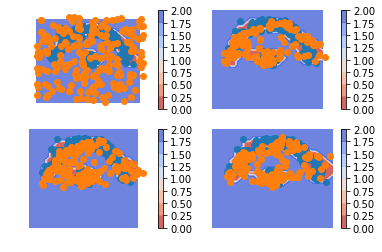

iteration  113
0.103045285 0.027431177 0.802897 -0.7272829


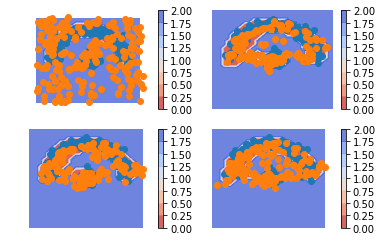

iteration  114
0.01288116 0.026938966 0.7729409 -0.7869987


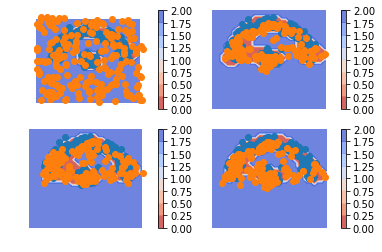

iteration  115
0.03223473 0.023259815 0.82923007 -0.82025516


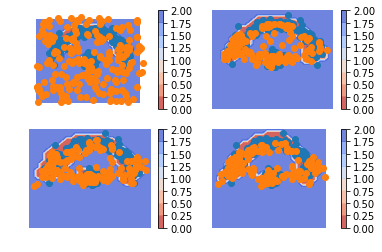

iteration  116
0.1043998 0.018930202 0.8224361 -0.7369665


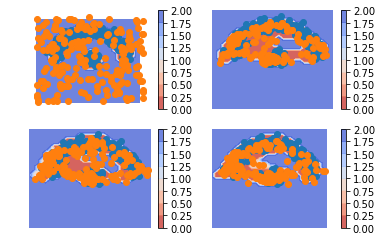

iteration  117
0.20637709 0.014139131 0.80395126 -0.6117133


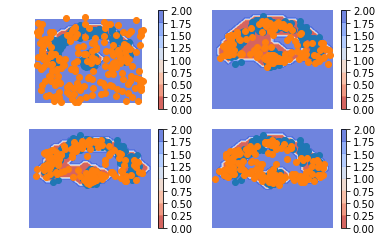

iteration  118
0.12891662 0.009988575 0.8139124 -0.6949843


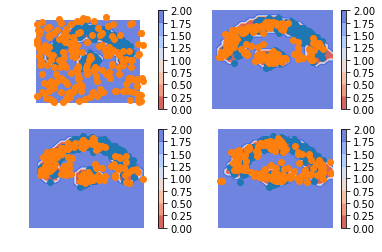

iteration  119
0.059384942 0.0067121782 0.8298977 -0.77722496


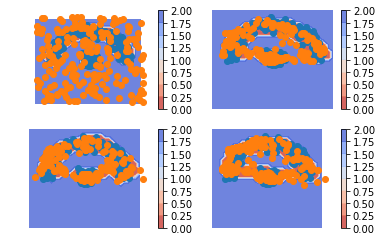

iteration  120
0.04912573 0.004482281 0.8116387 -0.76699525


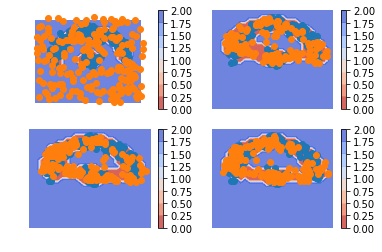

iteration  121
0.069233894 0.0040257834 0.7941928 -0.72898465


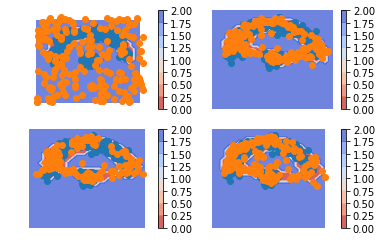

iteration  122
0.027273834 0.005148248 0.78255314 -0.76042753


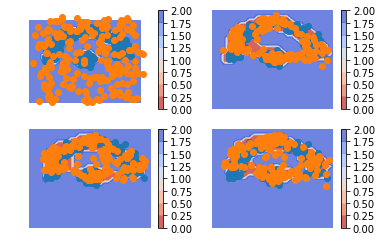

iteration  123
0.0142682195 0.0073869624 0.7786781 -0.7717969


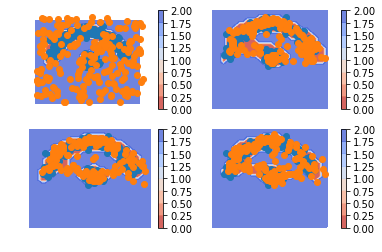

iteration  124
0.046316564 0.010386857 0.8194389 -0.7835092


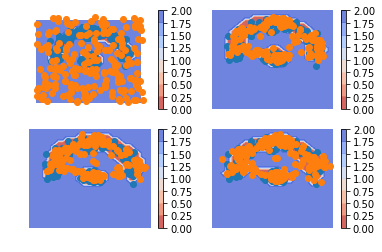

iteration  125
0.12262356 0.012018963 0.82536674 -0.71476215


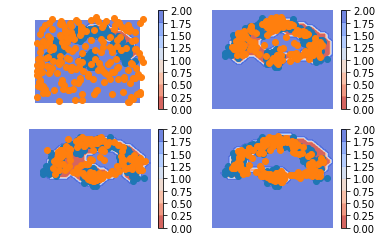

iteration  126
0.08410221 0.013212802 0.7938254 -0.722936


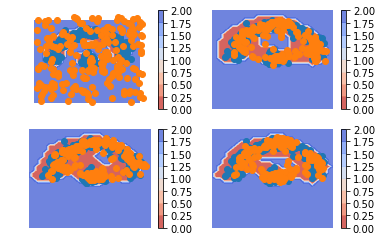

iteration  127
0.032942414 0.013330358 0.81283915 -0.7932271


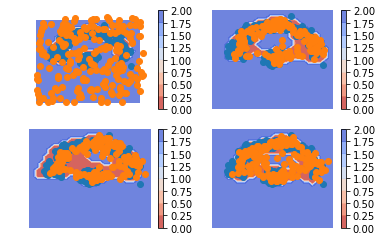

iteration  128
0.03987193 0.012546691 0.8153893 -0.78806406


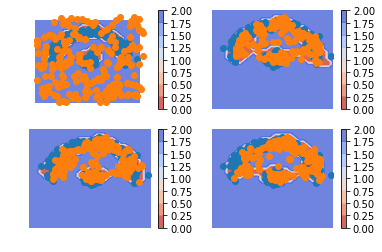

iteration  129
0.020580769 0.011263696 0.80497026 -0.79565316


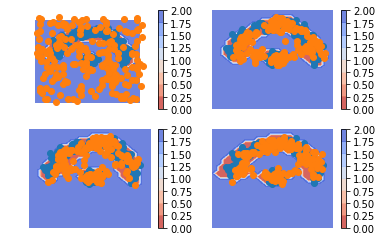

iteration  130
0.033382595 0.0101536065 0.8055167 -0.7822877


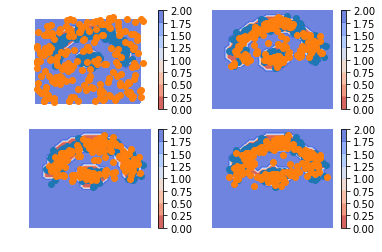

iteration  131
0.017550766 0.009262744 0.82715905 -0.818871


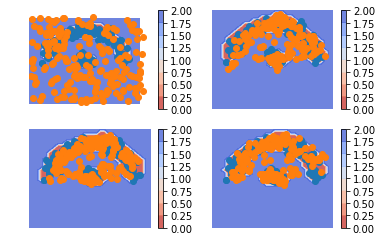

iteration  132
0.13077861 0.008538403 0.8380598 -0.7158196


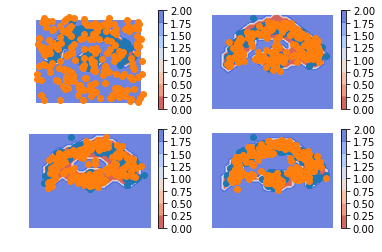

iteration  133
0.091184795 0.007906052 0.8251883 -0.74190956


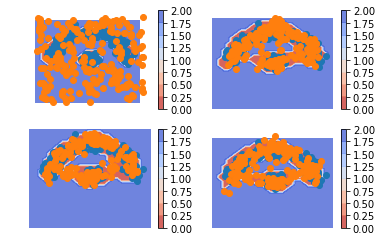

iteration  134
0.042686343 0.0069938954 0.80922943 -0.773537


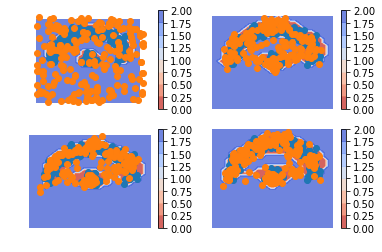

iteration  135
0.067133665 0.005959293 0.82111806 -0.75994366


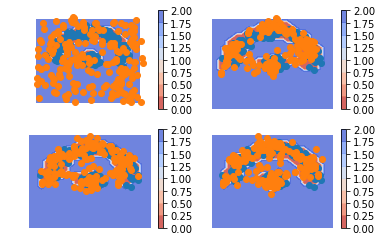

iteration  136
0.055791497 0.0051846057 0.83639216 -0.78578526


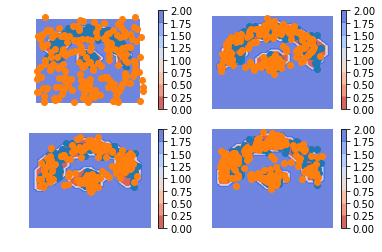

iteration  137
0.060254335 0.0054734563 0.80689037 -0.75210947


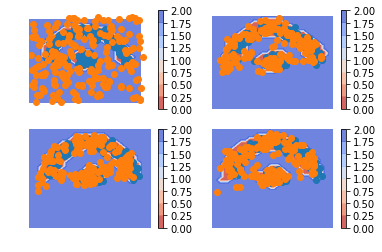

iteration  138
-0.0012024045 0.007720169 0.8138492 -0.8227718


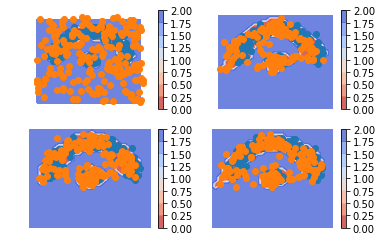

iteration  139
0.004428923 0.01119572 0.83415616 -0.84092295


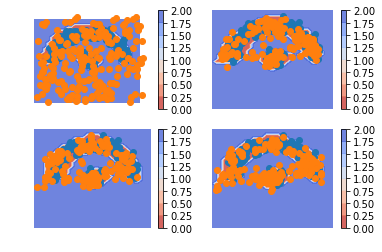

iteration  140
0.11679989 0.014378611 0.86413544 -0.76171416


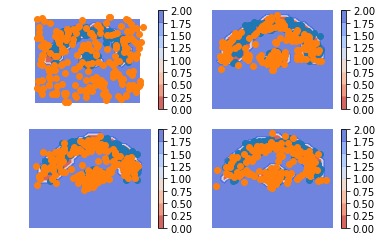

iteration  141
0.12777376 0.017184515 0.8069699 -0.6963806


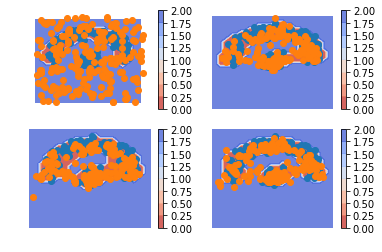

iteration  142
0.0048609376 0.018370103 0.79737264 -0.8108818


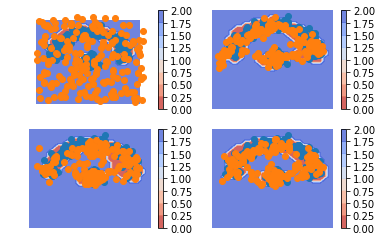

iteration  143
0.02536434 0.018294541 0.8328181 -0.82574826


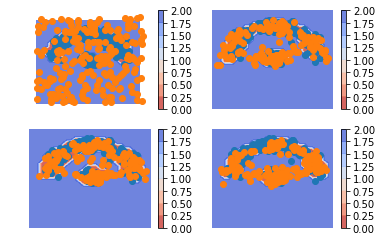

iteration  144
0.121904135 0.01660885 0.8132698 -0.7079745


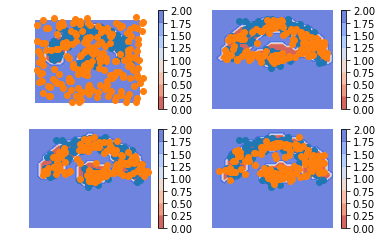

iteration  145
0.038689137 0.013693697 0.774568 -0.7495726


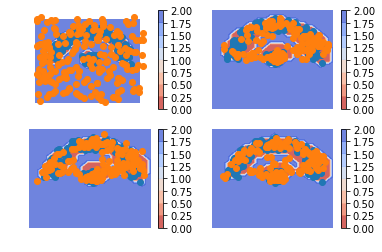

iteration  146
0.046363592 0.010724031 0.8050354 -0.7693958


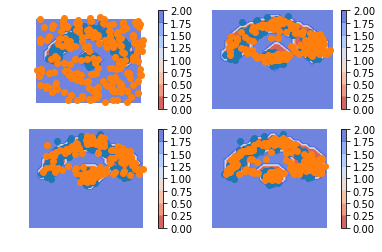

iteration  147
0.0089764 0.008073231 0.7881372 -0.787234


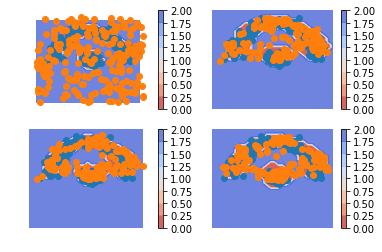

iteration  148
0.047236085 0.005786497 0.8234316 -0.781982


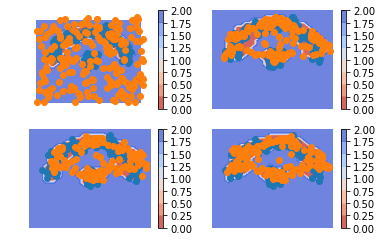

iteration  149
0.03465438 0.004257633 0.8085803 -0.7781835


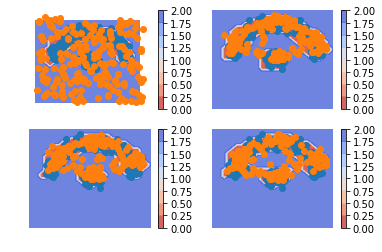

iteration  150
0.019400239 0.0033135638 0.84488183 -0.82879514


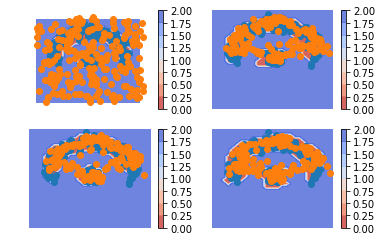

iteration  151
0.04347521 0.0030907702 0.79867566 -0.75829124


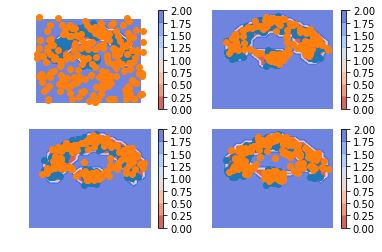

iteration  152
0.022072136 0.0034039994 0.78677064 -0.7681025


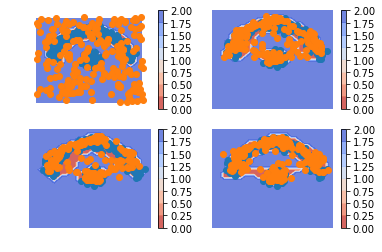

iteration  153
0.014429331 0.0042880904 0.8248348 -0.81469357


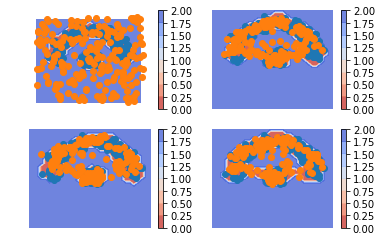

iteration  154
0.07563448 0.0053207246 0.8043955 -0.73408175


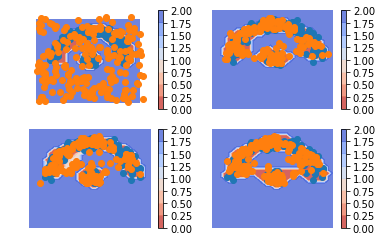

iteration  155
0.21268392 0.006218016 0.7799045 -0.5734386


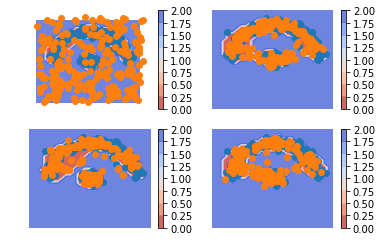

iteration  156
0.10810608 0.0071367947 0.8186631 -0.71769387


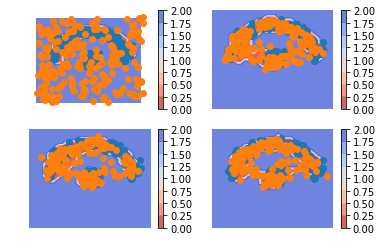

iteration  157
0.028122485 0.008053675 0.78446484 -0.764396


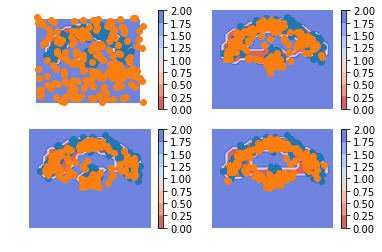

iteration  158
0.09798485 0.008467876 0.81548595 -0.72596896


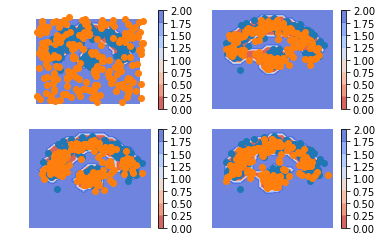

iteration  159
0.0022299886 0.008741905 0.79681134 -0.80332327


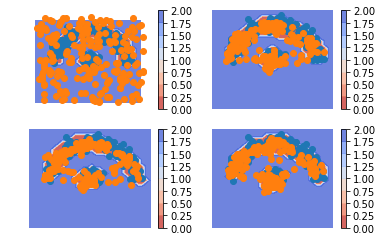

iteration  160
0.022536576 0.009015682 0.8160435 -0.8025226


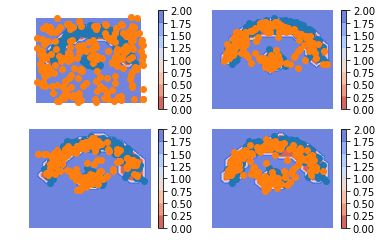

iteration  161
0.075243354 0.008875452 0.80810344 -0.7417355


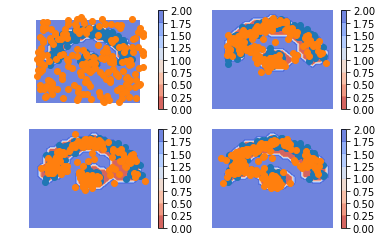

iteration  162
0.025636435 0.008165479 0.8233835 -0.80591255


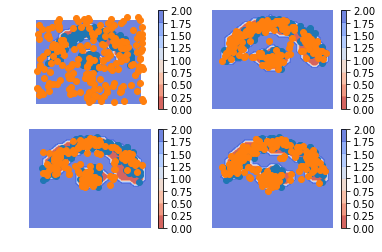

iteration  163
0.065277755 0.006951355 0.8412432 -0.7829168


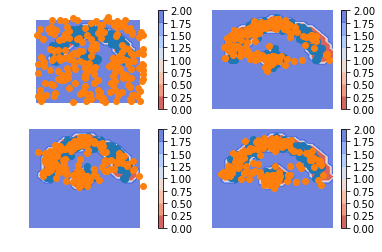

iteration  164
0.09057492 0.0060302406 0.81612283 -0.7315782


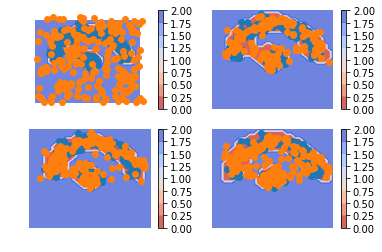

iteration  165
0.030336201 0.0050870087 0.83769596 -0.8124468


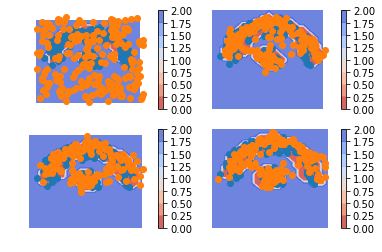

iteration  166
0.09732139 0.0041255234 0.85421365 -0.7610178


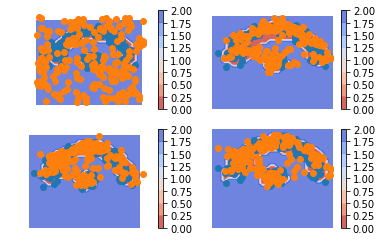

iteration  167
0.024931908 0.0034006024 0.81878877 -0.7972575


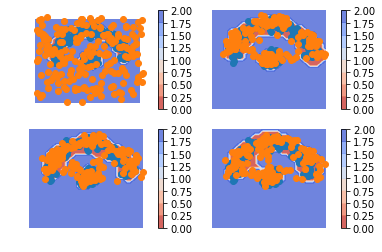

iteration  168
0.05129409 0.002885794 0.8146191 -0.76621085


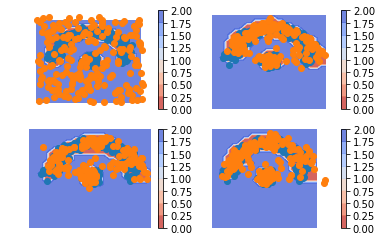

iteration  169
0.0358423 0.002751927 0.796878 -0.7637876


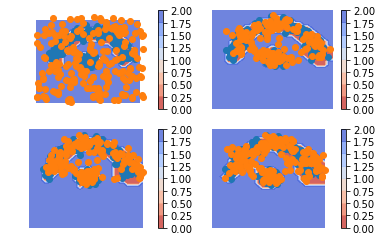

iteration  170
0.020427108 0.0027171539 0.8397473 -0.82203734


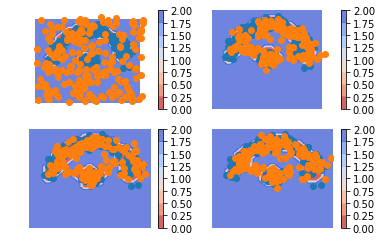

iteration  171
-0.021682143 0.0028424407 0.76510084 -0.7896254


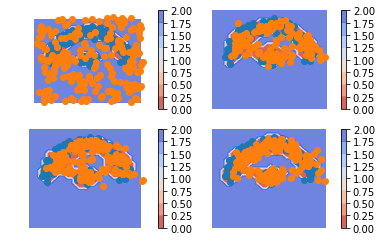

iteration  172
-0.008127034 0.002912833 0.80944884 -0.8204887


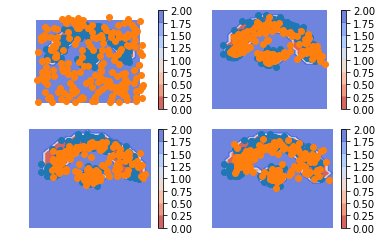

iteration  173
0.05418843 0.0028540313 0.8049784 -0.753644


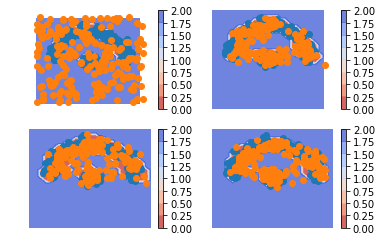

iteration  174
-0.029169738 0.0025678347 0.7828631 -0.81460065


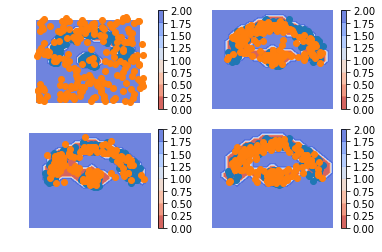

iteration  175
-0.020913363 0.0021559761 0.81733096 -0.8404003


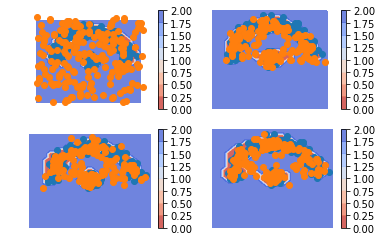

iteration  176
0.06735712 0.0018662664 0.8219937 -0.75650287


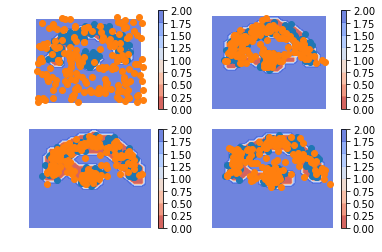

iteration  177
0.014791489 0.001571566 0.83463144 -0.82141155


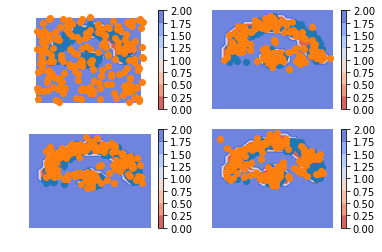

iteration  178
0.0781697 0.0013513782 0.8281541 -0.75133574


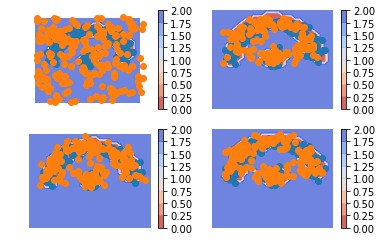

iteration  179
0.09628737 0.0015393844 0.8295868 -0.73483884


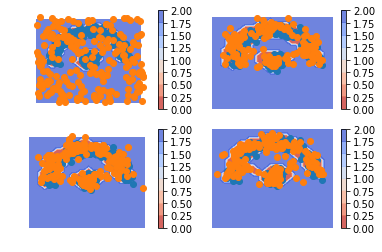

iteration  180
0.028649926 0.0018635122 0.8231455 -0.7963591


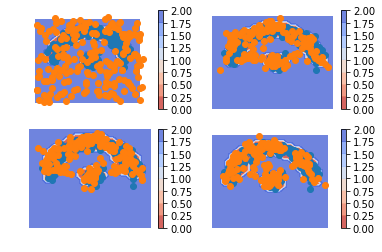

iteration  181
-0.046498418 0.0023404146 0.7984182 -0.8472571


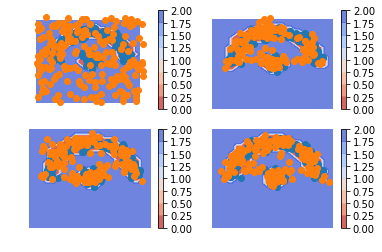

iteration  182
0.016065836 0.0028731343 0.813326 -0.8001333


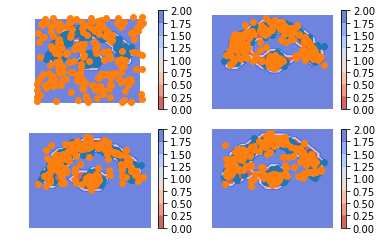

iteration  183
0.001098752 0.0034258792 0.81868076 -0.8210079


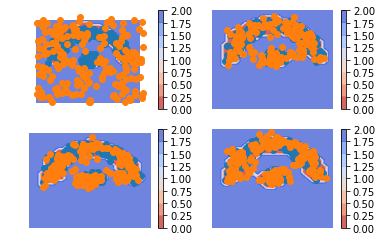

iteration  184
0.021465242 0.0043597696 0.8305987 -0.81349325


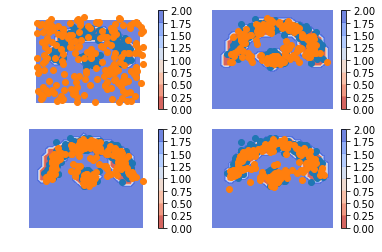

iteration  185
0.003094554 0.0052543087 0.79436743 -0.7965272


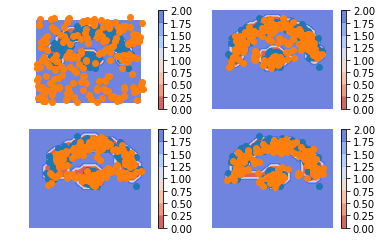

iteration  186
0.0034679174 0.006293462 0.8274431 -0.8302687


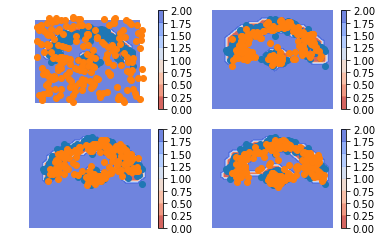

iteration  187
0.1037696 0.0071401563 0.8410543 -0.7444249


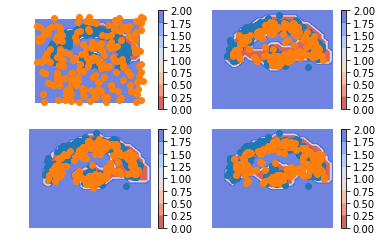

iteration  188
0.033928633 0.0076535465 0.8385576 -0.8122825


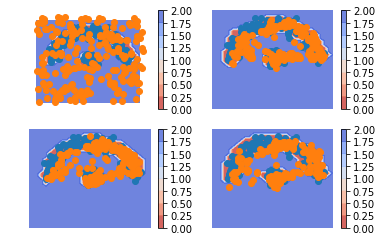

iteration  189
0.20179659 0.0081203105 0.80988973 -0.61621344


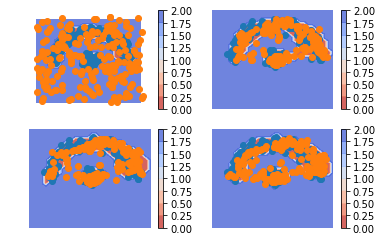

iteration  190
0.07440019 0.008386304 0.8089426 -0.74292874


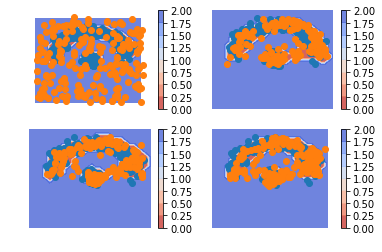

iteration  191
-0.03432399 0.008322857 0.78398526 -0.8266321


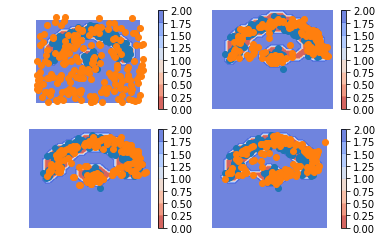

iteration  192
0.0030583143 0.0083605405 0.83245295 -0.8377552


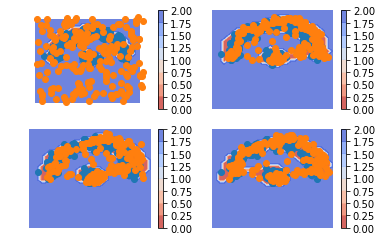

iteration  193
0.06810522 0.008200332 0.8128591 -0.75295424


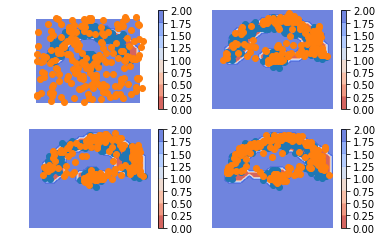

iteration  194
0.050769746 0.007872324 0.8088771 -0.7659797


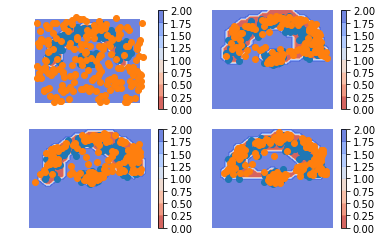

iteration  195
0.03010279 0.007528423 0.81323195 -0.7906576


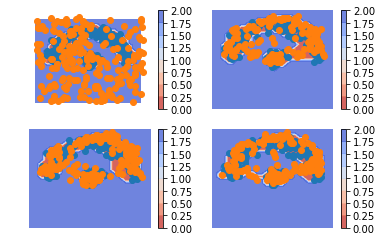

iteration  196
0.029700637 0.0070031546 0.7726553 -0.7499578


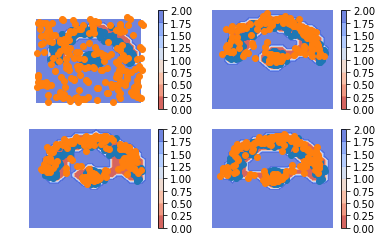

iteration  197
0.025909603 0.0062413365 0.8288237 -0.8091554


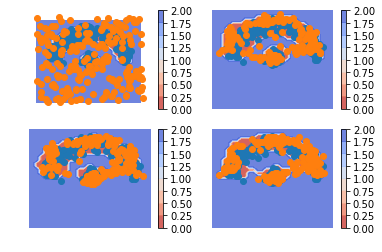

iteration  198
-0.016082287 0.005777891 0.7753993 -0.7972595


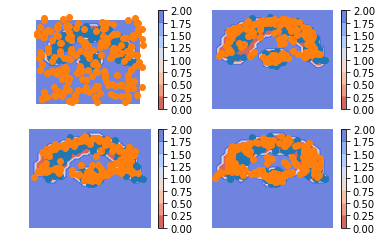

iteration  199
0.033209264 0.004621381 0.84008914 -0.81150126


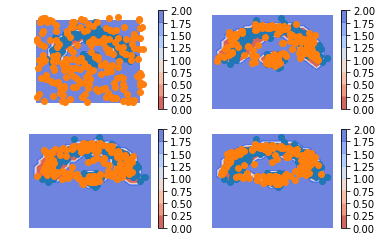

iteration  200
0.06777048 0.0036736417 0.8199122 -0.7558153


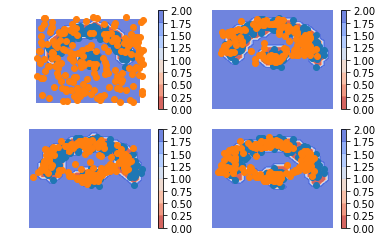

iteration  201
0.03723681 0.0028308288 0.7811674 -0.7467614


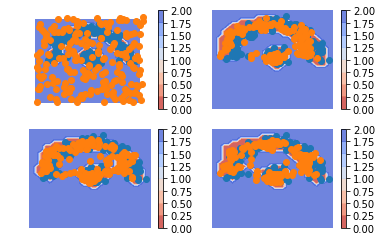

iteration  202
0.059767306 0.0021699301 0.8178156 -0.7602182


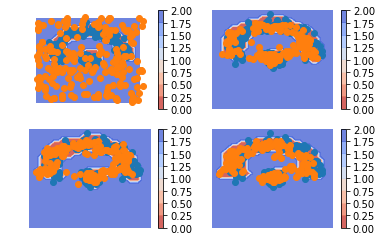

iteration  203
0.022912085 0.0016548996 0.8164022 -0.79514503


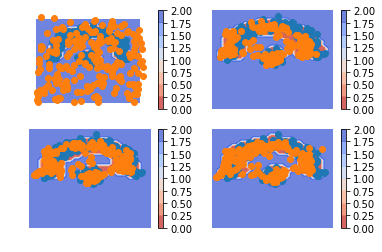

iteration  204
0.092986465 0.0016708818 0.81308866 -0.7217731


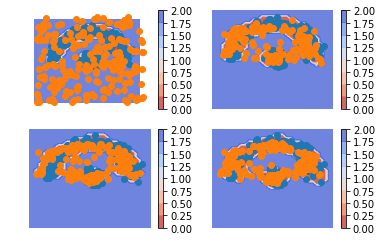

iteration  205
0.017876863 0.0017703499 0.8060613 -0.78995484


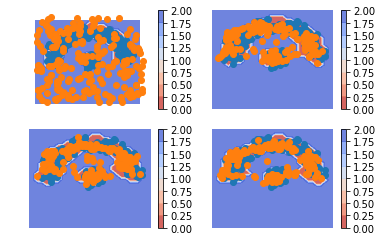

iteration  206
-0.037312627 0.0020640336 0.8206769 -0.8600536


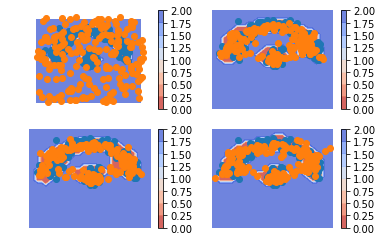

iteration  207
0.14706421 0.002508328 0.8487807 -0.7042248


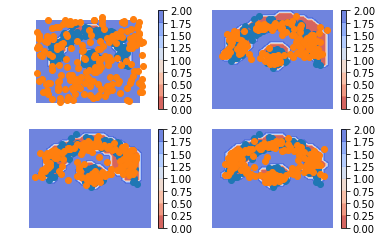

iteration  208
0.13805264 0.0025502464 0.804624 -0.6691216


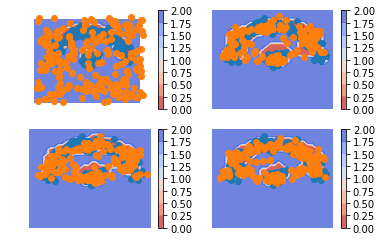

iteration  209
0.06402588 0.0022688366 0.8210996 -0.75934255


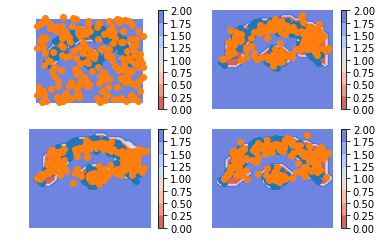

iteration  210
0.030693293 0.0019944324 0.8048941 -0.7761952


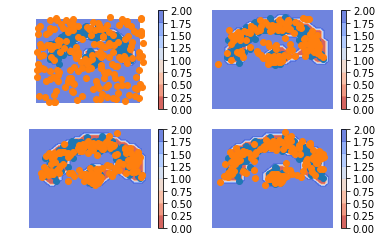

iteration  211
0.07898265 0.0020751583 0.82198983 -0.7450823


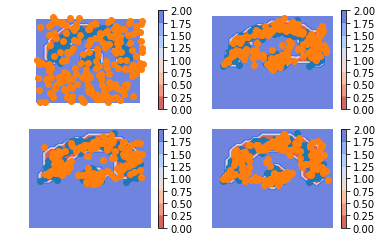

iteration  212
0.021234095 0.0021579866 0.8225314 -0.8034553


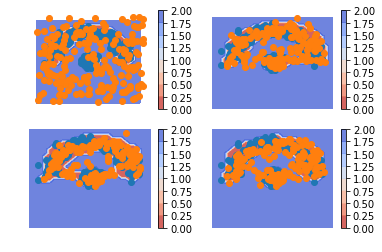

iteration  213
0.019060075 0.00230478 0.8443769 -0.82762164


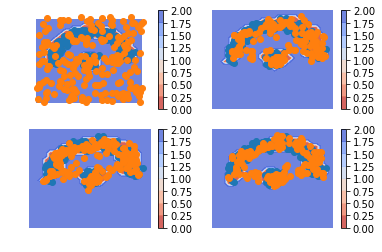

iteration  214
-0.031856418 0.0025045236 0.8000014 -0.8343623


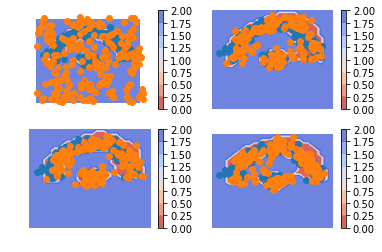

iteration  215
0.018615127 0.002702027 0.78574985 -0.7698367


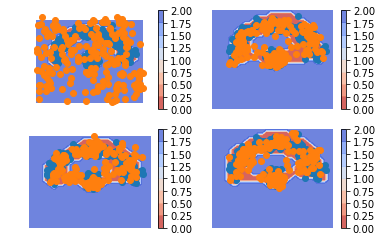

iteration  216
-0.0018176436 0.0027399366 0.8110542 -0.81561184


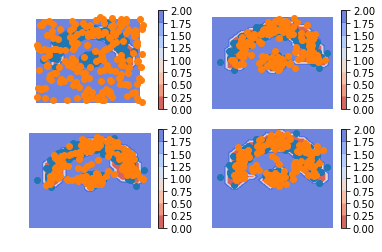

iteration  217
0.017717361 0.0026452984 0.8117082 -0.79663616


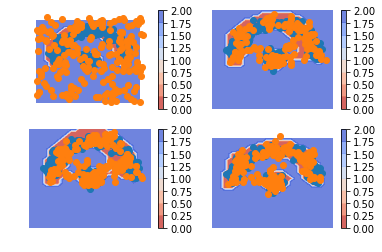

iteration  218
-0.012457669 0.0023220703 0.80934596 -0.8241257


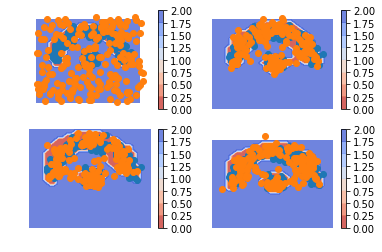

iteration  219
-0.007303059 0.002201773 0.79621625 -0.8057211


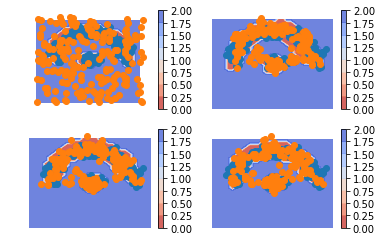

iteration  220
0.019493163 0.001965536 0.8280965 -0.81056887


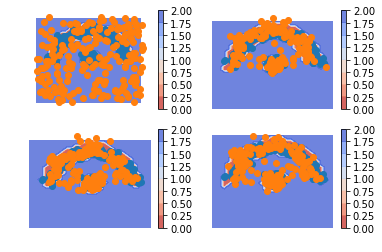

iteration  221
0.015004218 0.0017949984 0.8205534 -0.8073442


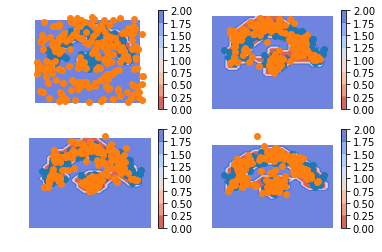

iteration  222
0.028573036 0.0015623348 0.8119751 -0.78496444


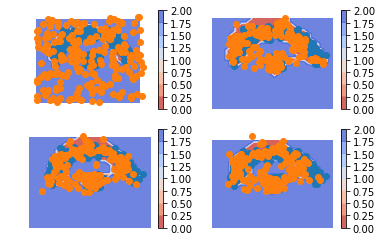

iteration  223
0.063217044 0.001564237 0.83313835 -0.77148557


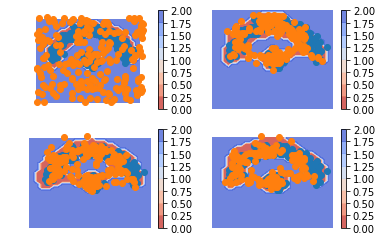

iteration  224
0.001935482 0.0018985355 0.83017385 -0.8301369


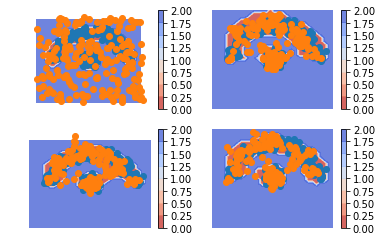

iteration  225
-0.00564301 0.0022973628 0.8206646 -0.82860494


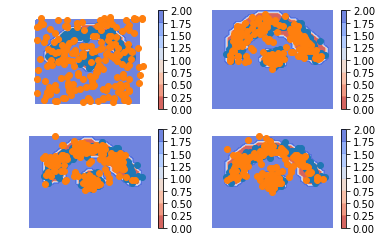

iteration  226
-0.043240786 0.0028372598 0.7977506 -0.8438286


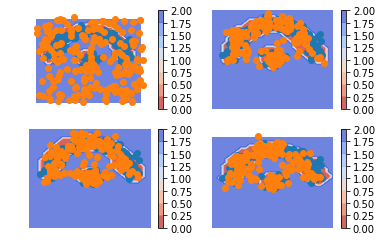

iteration  227
-0.024407804 0.0034239546 0.8342524 -0.86208415


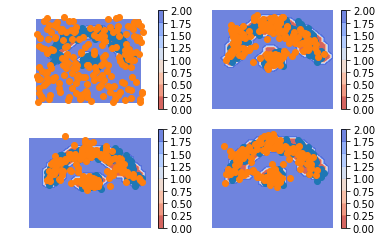

iteration  228
0.071944654 0.0036800886 0.8074098 -0.7391453


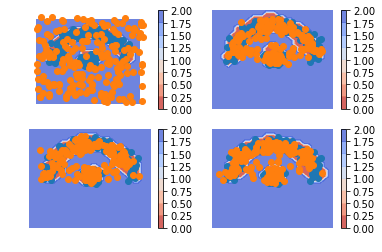

iteration  229
0.021350265 0.0036472483 0.8055383 -0.7878353


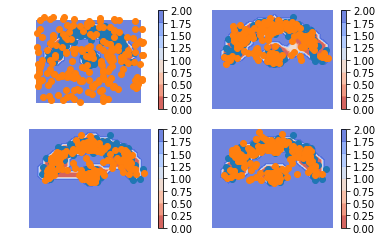

iteration  230
0.06637442 0.0036166979 0.79972184 -0.7369641


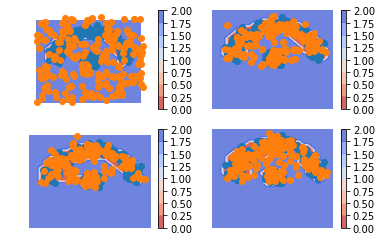

iteration  231
0.090516925 0.0033460374 0.84317505 -0.75600415


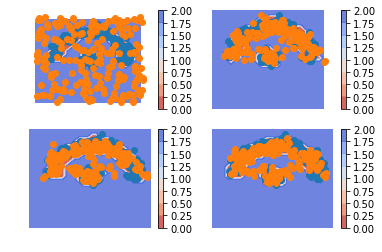

iteration  232
0.056007147 0.0030769627 0.80823964 -0.75530946


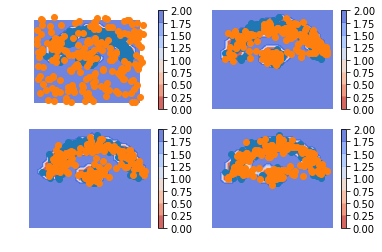

iteration  233
0.0057540536 0.00252648 0.77106667 -0.7678391


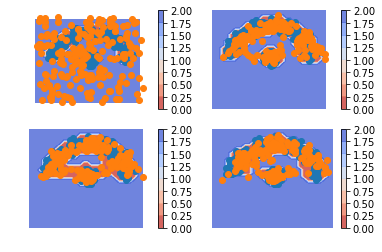

iteration  234
0.0896377 0.0021668747 0.85093963 -0.7634688


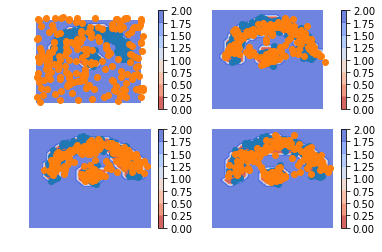

iteration  235
0.015224576 0.0022502223 0.81980425 -0.80682987


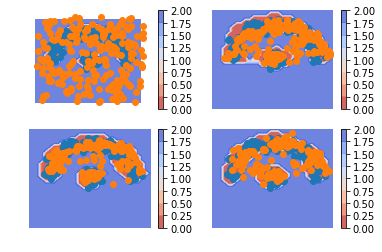

iteration  236
0.05411482 0.0027661768 0.8202257 -0.7688771


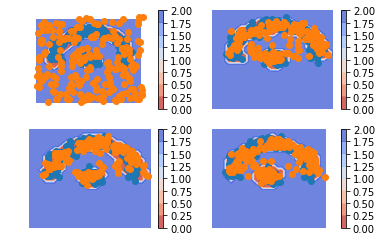

iteration  237
-0.010079563 0.0032627927 0.7868997 -0.80024207


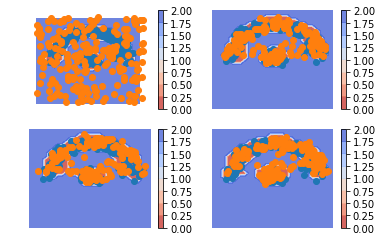

iteration  238
-0.053261876 0.0038564424 0.8230697 -0.880188


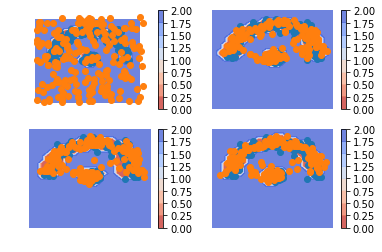

iteration  239
0.03205532 0.004029275 0.8378272 -0.80980116


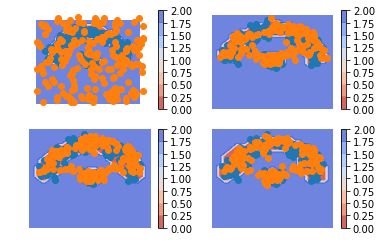

iteration  240
0.0165416 0.0040529193 0.8061217 -0.79363304


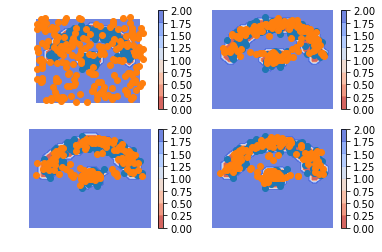

iteration  241
-0.014978468 0.0041070418 0.80918765 -0.8282732


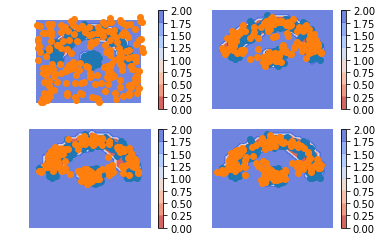

iteration  242
0.04176861 0.004169515 0.8209561 -0.783357


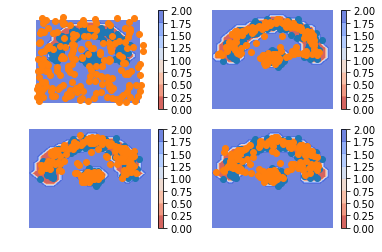

iteration  243
-0.046512246 0.0042409203 0.7878991 -0.83865225


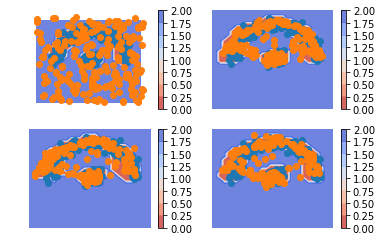

iteration  244
-0.05149871 0.0046451655 0.79299444 -0.8491383


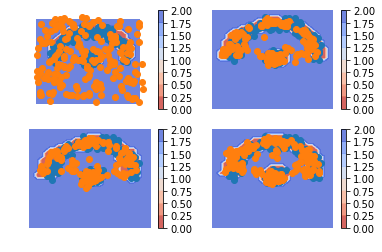

iteration  245
-0.0051103234 0.0050041666 0.7870333 -0.7971478


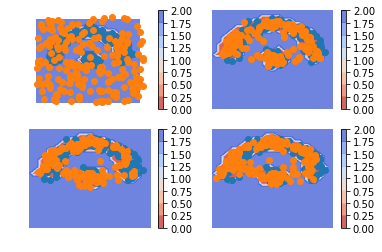

iteration  246
-0.010435164 0.0052564074 0.81570256 -0.83139414


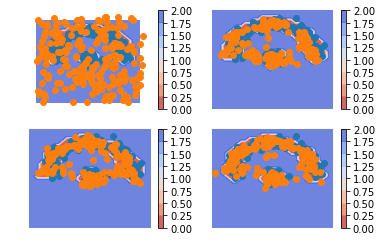

iteration  247
0.048545003 0.005270156 0.8168054 -0.7735306


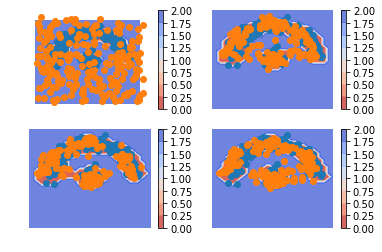

iteration  248
0.038027585 0.0059237196 0.80633074 -0.7742269


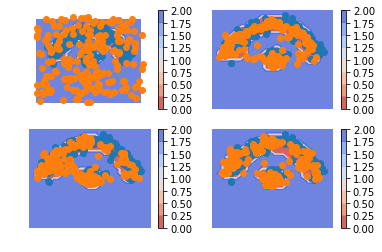

iteration  249
0.0061086416 0.006434512 0.838969 -0.83929485


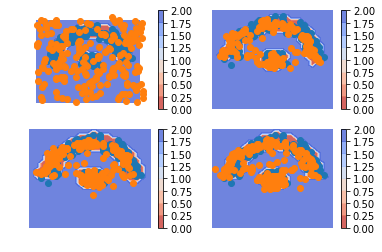

iteration  250
-0.011625886 0.006318088 0.8176632 -0.8356072


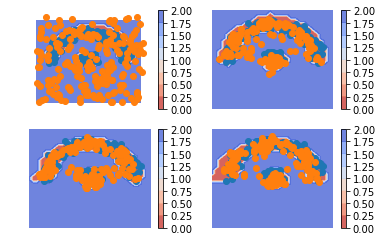

iteration  251
0.07419008 0.006420837 0.83542836 -0.7676591


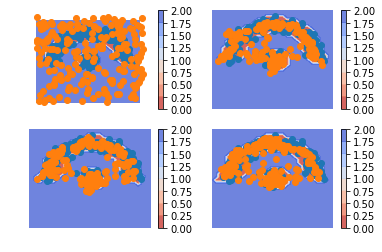

iteration  252
-0.022276342 0.0062690694 0.7882414 -0.8167868


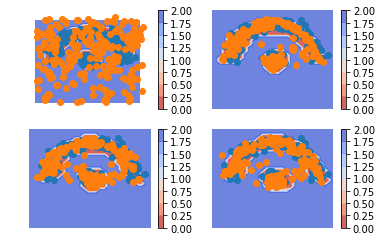

iteration  253
-0.076352775 0.00611588 0.79328555 -0.8757542


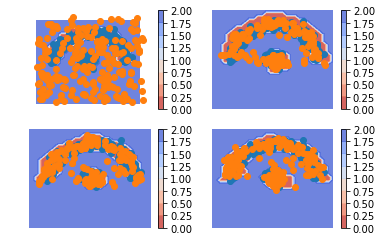

iteration  254
0.009146988 0.0059807836 0.8115328 -0.8083666


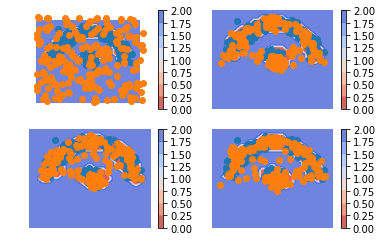

iteration  255
-0.06816399 0.0060104425 0.78756 -0.8617344


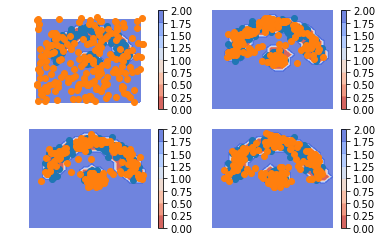

iteration  256
0.022314012 0.005808727 0.8063657 -0.7898604


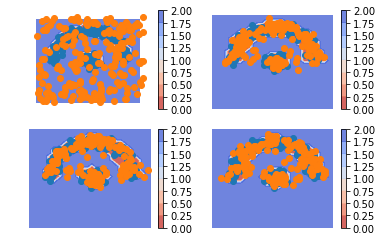

iteration  257
0.045071065 0.005787239 0.8170517 -0.7777679


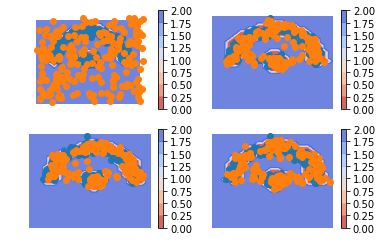

iteration  258
0.03624606 0.005448726 0.8106828 -0.7798854


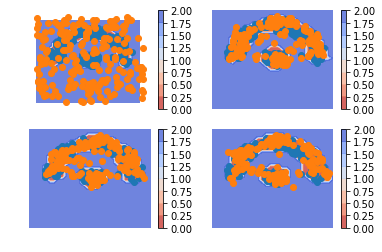

iteration  259
0.054020226 0.00480043 0.80383104 -0.75461125


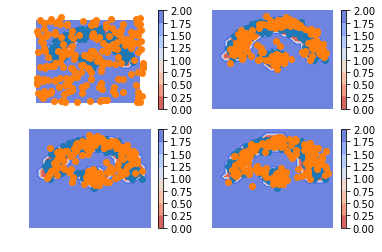

iteration  260
-0.023582816 0.0039681364 0.7949384 -0.8224893


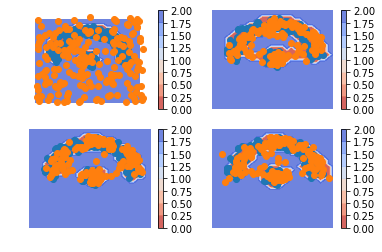

iteration  261
-0.036353707 0.0032989911 0.81217 -0.85182273


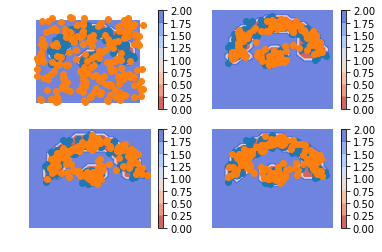

iteration  262
0.02666998 0.0025750059 0.82571244 -0.80161744


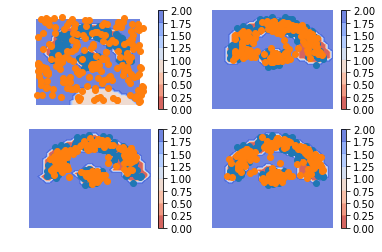

iteration  263
-0.046820104 0.0021144117 0.8080651 -0.85699964


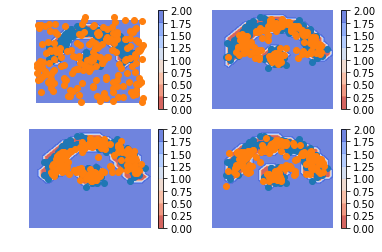

iteration  264
-0.061505854 0.0018173647 0.7767522 -0.8400754


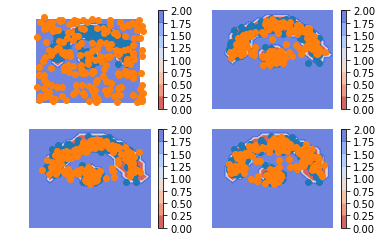

iteration  265
0.0008749962 0.0015642351 0.8432759 -0.8439652


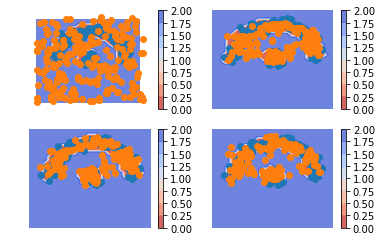

iteration  266
0.013936341 0.0017709367 0.7927339 -0.7805685


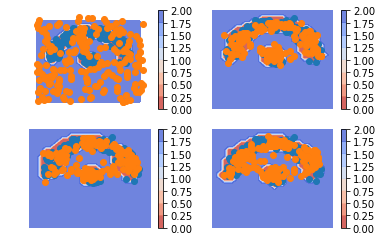

iteration  267
-0.06472707 0.0024303882 0.81982845 -0.8869859


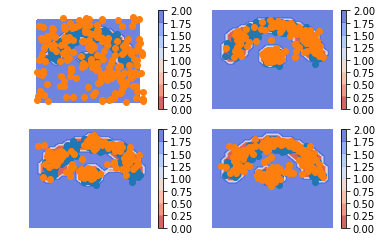

iteration  268
0.010452747 0.0032784566 0.82625544 -0.8190811


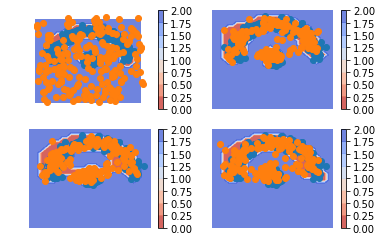

iteration  269
0.019934952 0.0040279906 0.79982626 -0.7839193


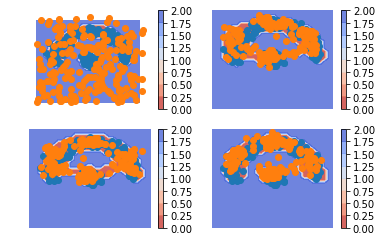

iteration  270
0.070275724 0.004624269 0.84909403 -0.78344256


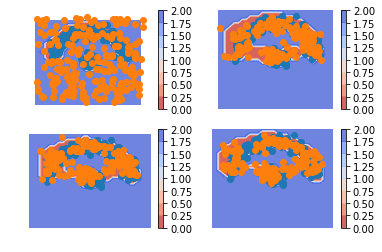

iteration  271
0.021283269 0.005222118 0.81948817 -0.80342704


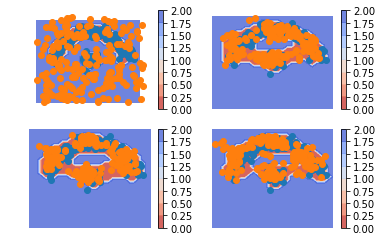

iteration  272
0.06797004 0.005619362 0.81980777 -0.7574571


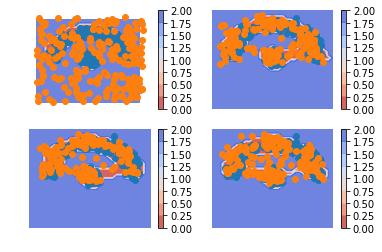

iteration  273
-0.027219594 0.0057070456 0.8549103 -0.88783693


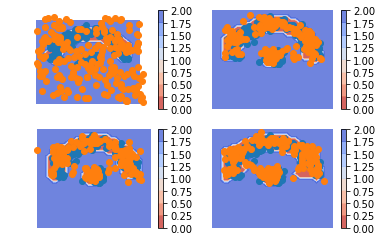

iteration  274
0.029770732 0.005621615 0.81728 -0.7931309


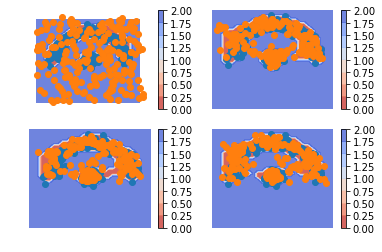

iteration  275
-0.01025486 0.005285226 0.7983311 -0.81387115


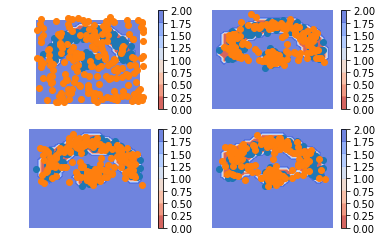

iteration  276
-0.04711467 0.0050270897 0.8147112 -0.866853


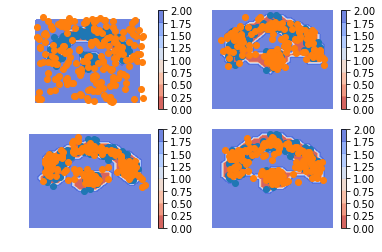

iteration  277
0.030726492 0.004958404 0.83088475 -0.80511665


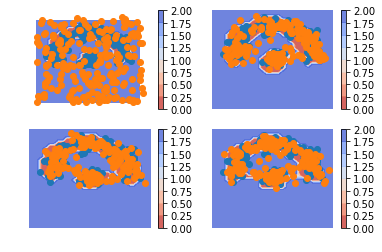

iteration  278
-0.027518809 0.0050476165 0.79369646 -0.8262629


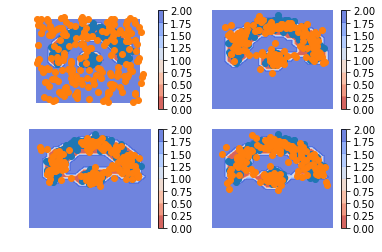

iteration  279
-0.045811176 0.005186084 0.79111516 -0.8421124


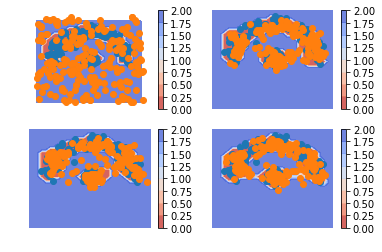

iteration  280
0.023877978 0.005422309 0.84682393 -0.82836825


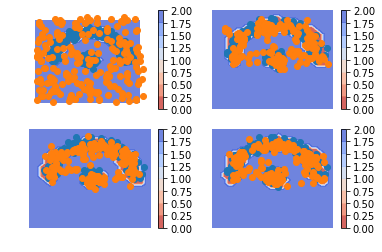

iteration  281
0.09582466 0.0056004673 0.8440956 -0.7538714


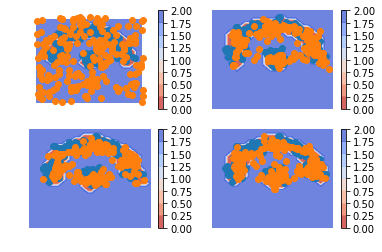

iteration  282
-0.00049090385 0.00591032 0.7866621 -0.79306334


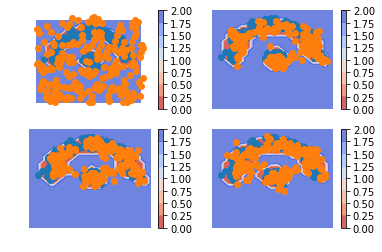

iteration  283
-0.0011463761 0.005933608 0.8215702 -0.8286502


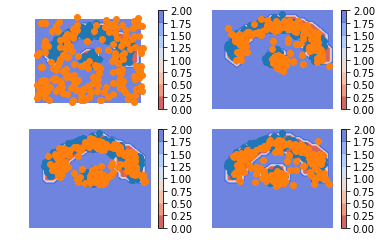

iteration  284
0.021439075 0.0059125414 0.8195306 -0.8040041


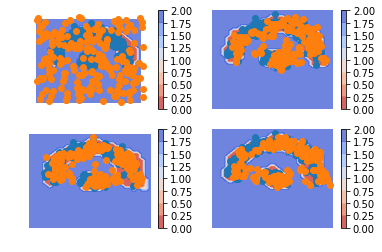

iteration  285
0.006629586 0.0057034194 0.83481836 -0.8338922


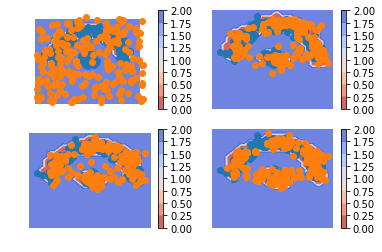

iteration  286
0.06321722 0.005528371 0.8469277 -0.78923887


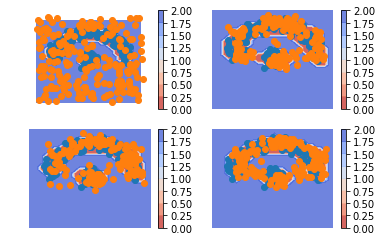

iteration  287
0.02078104 0.005388554 0.8281609 -0.8127684


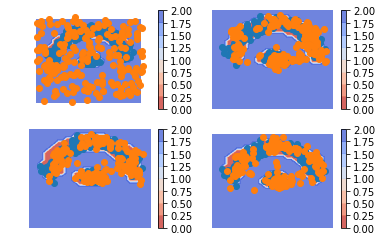

iteration  288
0.0135625005 0.005389055 0.8055286 -0.7973551


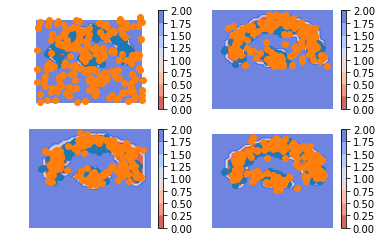

iteration  289
0.084232986 0.0055266656 0.7754221 -0.6967158


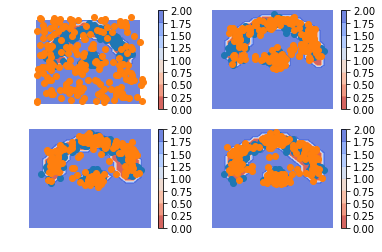

iteration  290
-0.03988117 0.005595466 0.7777283 -0.82320493


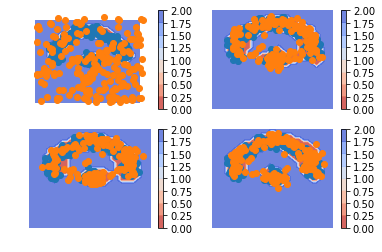

iteration  291
-0.003344059 0.0062570875 0.8194354 -0.8290366


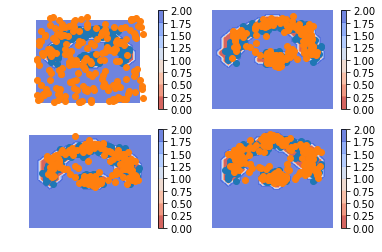

iteration  292
-0.035950482 0.0069289333 0.80206555 -0.84494495


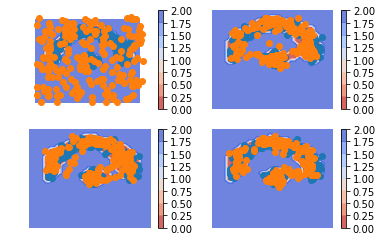

iteration  293
0.004353225 0.007875532 0.773069 -0.77659136


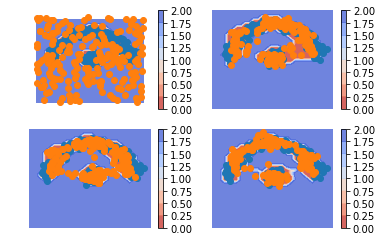

iteration  294
0.010027468 0.008191715 0.7855477 -0.7837119


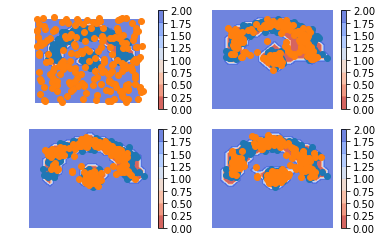

iteration  295
-0.009360075 0.008382488 0.8050729 -0.8228155


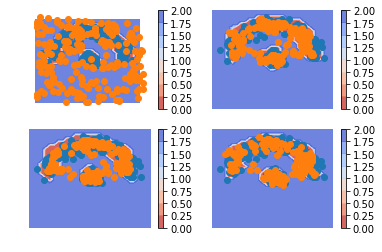

iteration  296
0.0098359585 0.008115637 0.8169335 -0.8152132


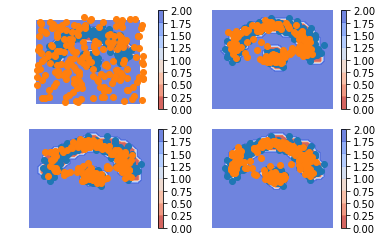

iteration  297
0.03005445 0.007606215 0.8098664 -0.7874182


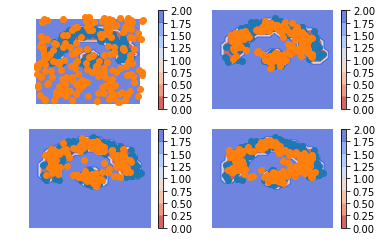

iteration  298
-0.02578491 0.0067611653 0.80618984 -0.83873594


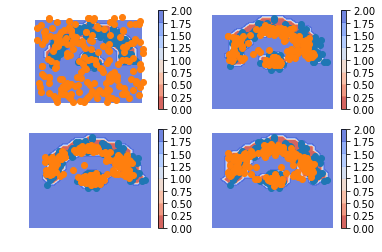

iteration  299
-0.059462488 0.0057575554 0.80138427 -0.8666043


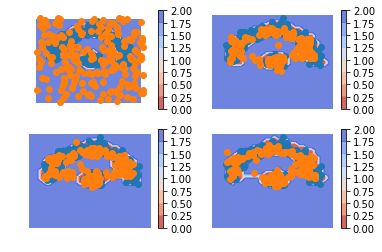

iteration  300
-0.032198846 0.005234389 0.8066485 -0.8440817


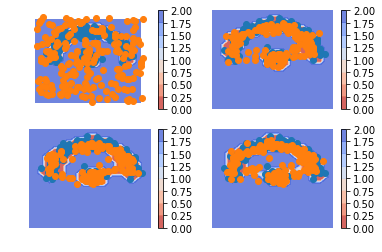

iteration  301
-0.08009499 0.005064733 0.77771246 -0.8628722


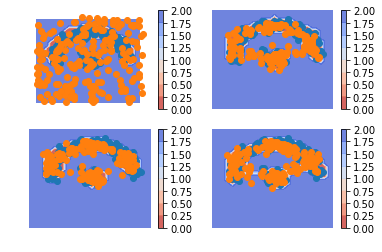

iteration  302
-0.059908807 0.0054533747 0.79922545 -0.8645876


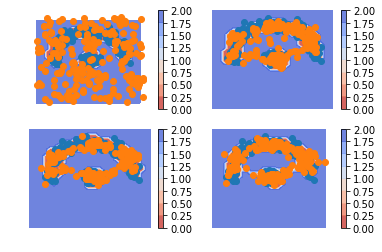

iteration  303
-0.057945967 0.0062764892 0.820559 -0.8847815


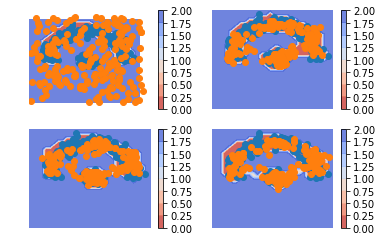

iteration  304
0.03675258 0.0073181707 0.84080523 -0.81137085


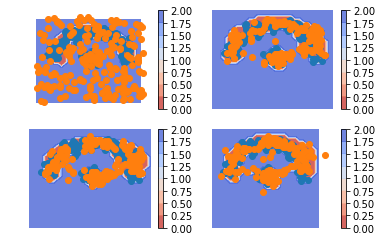

iteration  305
0.19906592 0.008603194 0.801523 -0.61106026


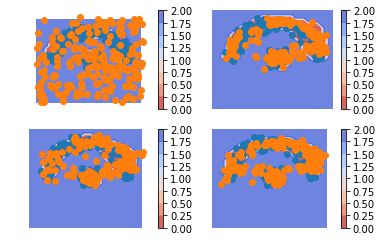

iteration  306
0.10245013 0.009534582 0.7939578 -0.7010423


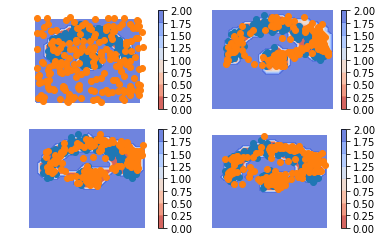

iteration  307
0.079966664 0.00985112 0.78758717 -0.7174716


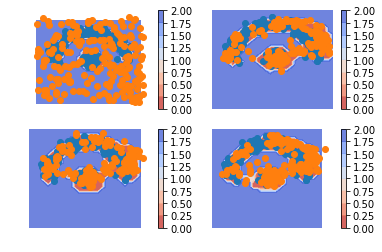

iteration  308
0.0587489 0.009251023 0.8198043 -0.7703064


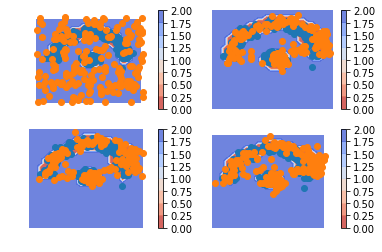

iteration  309
0.06229937 0.008425603 0.8287967 -0.7749229


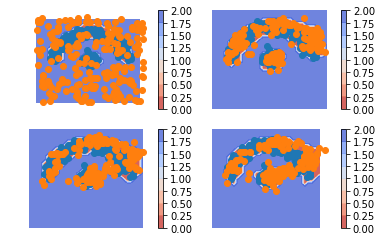

iteration  310
0.046814263 0.007987178 0.8267797 -0.78795266


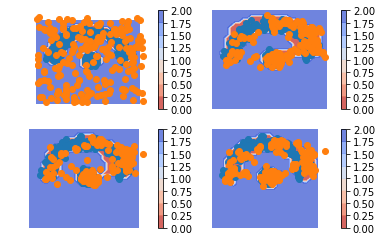

iteration  311
-0.025874794 0.007909756 0.8098517 -0.8436363


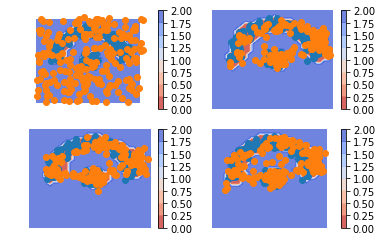

iteration  312
-0.00062435865 0.008516669 0.8251002 -0.8342412


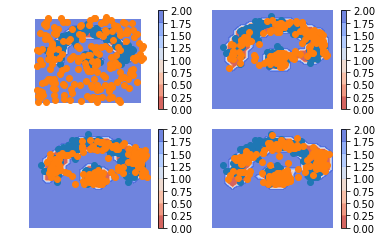

iteration  313
0.022758722 0.008958266 0.84376687 -0.8299664


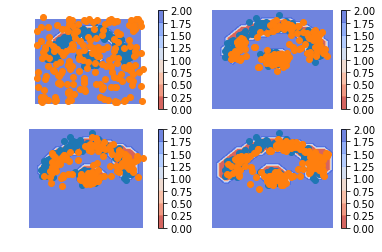

iteration  314
0.07693088 0.009170712 0.82102054 -0.7532604


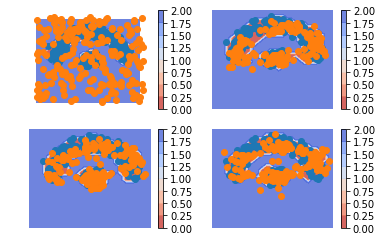

iteration  315
-0.020712614 0.009820103 0.80374515 -0.83427787


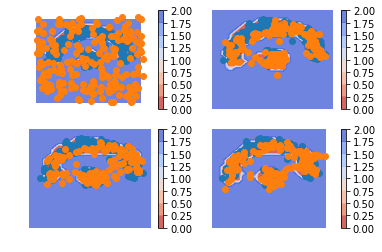

iteration  316
0.0006032586 0.0103829475 0.8172641 -0.8270438


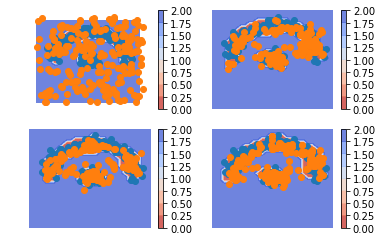

iteration  317
-0.006261468 0.011076226 0.79998124 -0.8173189


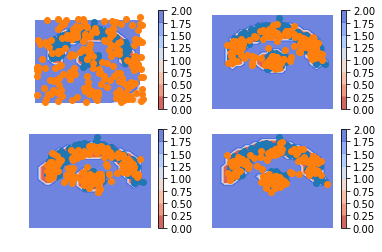

iteration  318
-0.018514931 0.01133667 0.8001037 -0.82995534


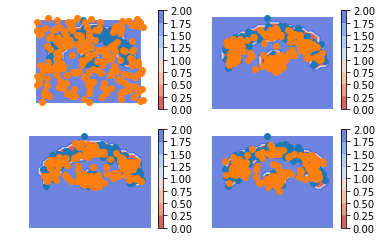

iteration  319
0.032263637 0.011152758 0.828155 -0.8070441


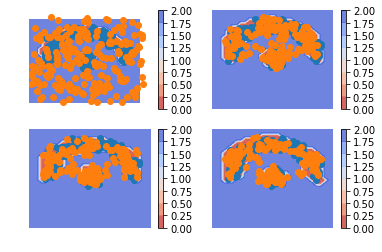

iteration  320
-0.049957156 0.01074568 0.77760255 -0.8383054


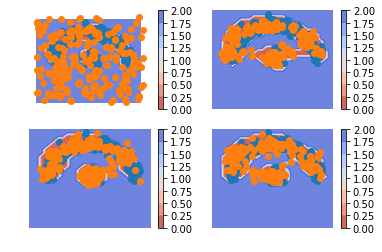

iteration  321
0.017775059 0.010499334 0.8101861 -0.8029104


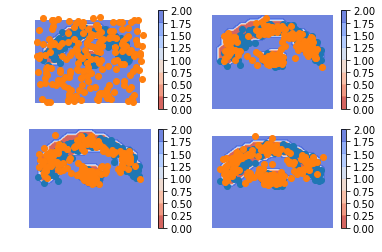

iteration  322
0.025178134 0.010308437 0.82401264 -0.80914295


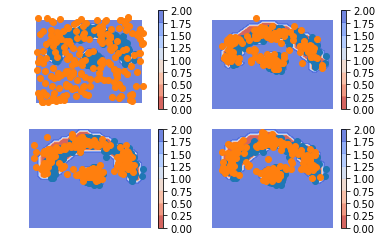

iteration  323
0.11425197 0.009707431 0.8368505 -0.732306


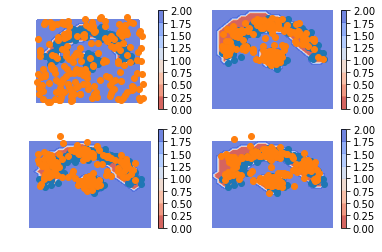

iteration  324
0.04065609 0.009190644 0.8146443 -0.7831788


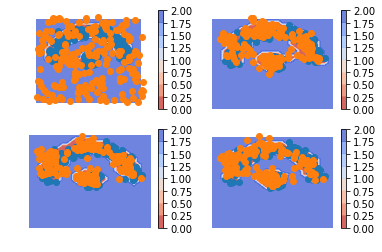

iteration  325
0.07300514 0.008365301 0.79777133 -0.73313147


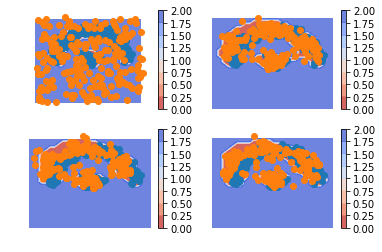

iteration  326
0.036538124 0.0075645265 0.8148943 -0.78592074


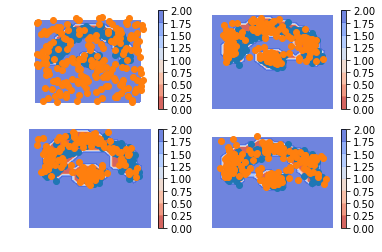

iteration  327
0.024508357 0.007095104 0.80048585 -0.7830726


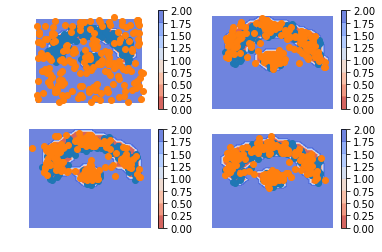

iteration  328
0.0005400181 0.006784457 0.8267166 -0.832961


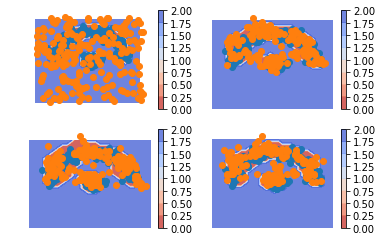

iteration  329
-0.02165097 0.006174554 0.8181964 -0.84602195


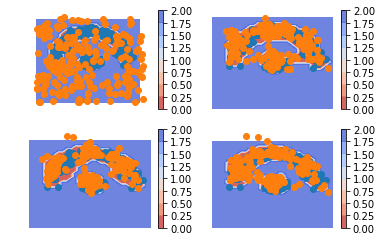

iteration  330
-0.006201923 0.005691123 0.82576925 -0.8376623


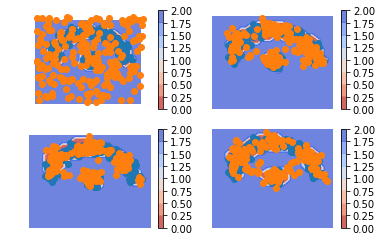

iteration  331
0.018958151 0.0056771087 0.80680156 -0.7935205


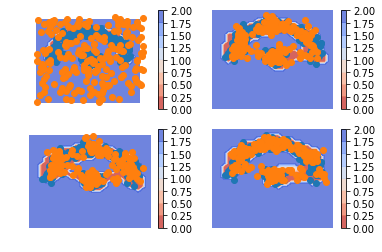

iteration  332
-0.001780808 0.006105172 0.83680516 -0.84469116


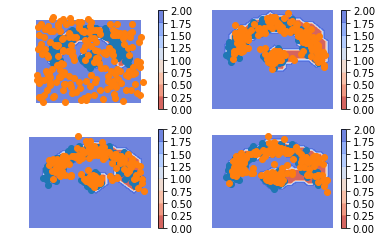

iteration  333
0.09739256 0.0064583705 0.8425175 -0.7515833


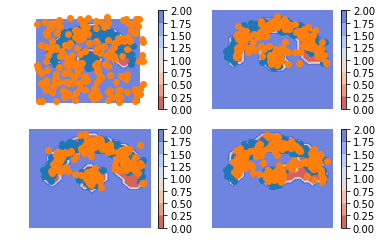

iteration  334
0.0018126965 0.0069618337 0.81293344 -0.8180826


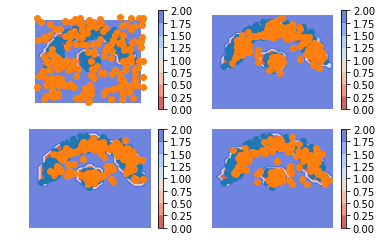

iteration  335
0.08245134 0.0072848233 0.85098976 -0.77582324


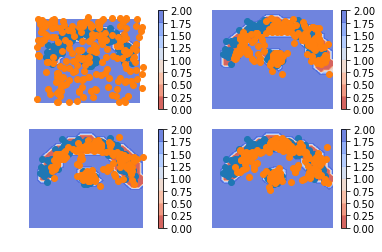

iteration  336
0.12381762 0.007495987 0.804878 -0.6885564


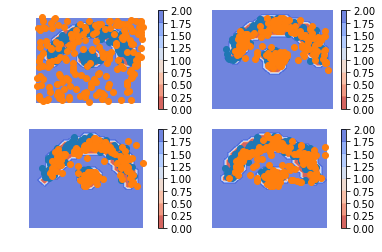

iteration  337
0.020421684 0.008128773 0.794479 -0.7821861


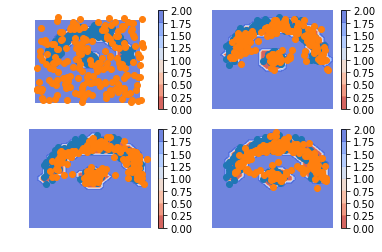

iteration  338
0.058680415 0.007738537 0.8114532 -0.76051134


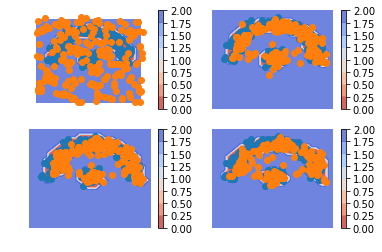

iteration  339
-0.010871053 0.0070771216 0.800331 -0.81827915


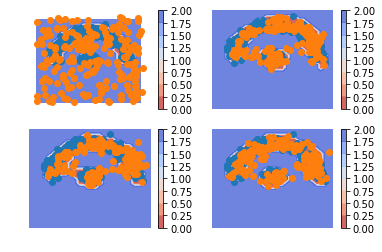

iteration  340
0.037763357 0.006630314 0.82542443 -0.7942914


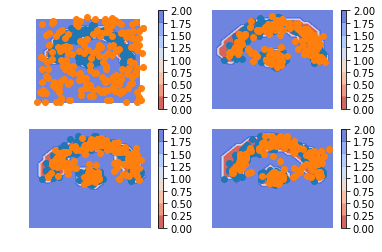

iteration  341
-0.010320008 0.0062336265 0.80460024 -0.8211539


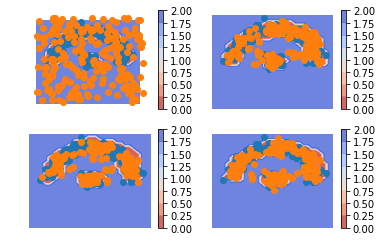

iteration  342
-0.03617412 0.0058159544 0.8180235 -0.8600136


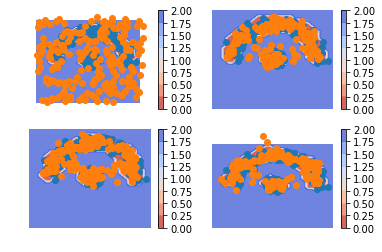

iteration  343
-0.024878442 0.0051810276 0.7975037 -0.82756317


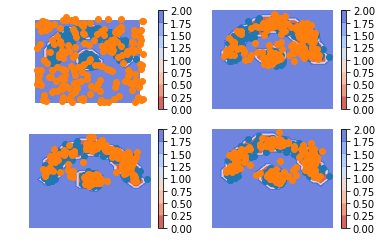

iteration  344
-0.054535747 0.0049051517 0.80165964 -0.86110055


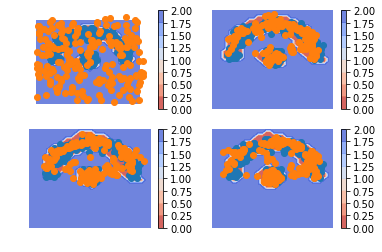

iteration  345
-0.070525765 0.0049471976 0.75621754 -0.8316905


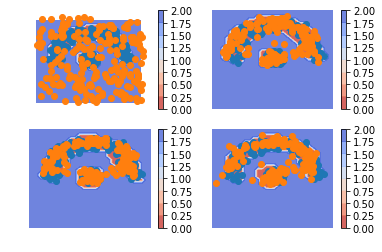

iteration  346
-0.103473604 0.0055120657 0.80122876 -0.9102144


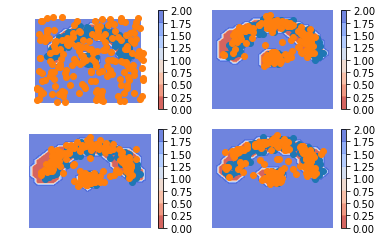

iteration  347
-0.004594207 0.0064088 0.84560394 -0.85660696


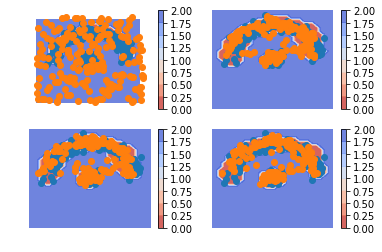

iteration  348
-0.041785717 0.007841742 0.78533137 -0.83495885


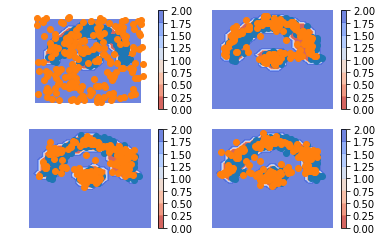

iteration  349
-0.02259922 0.010141257 0.8231727 -0.85591316


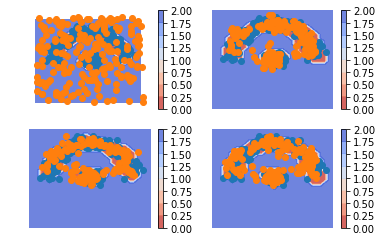

iteration  350
-0.03305 0.013092529 0.8055855 -0.851728


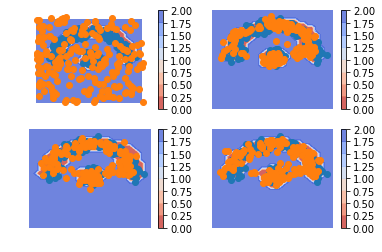

iteration  351
-0.009787083 0.015685137 0.80507255 -0.83054477


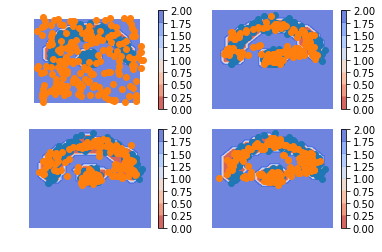

iteration  352
-0.05967456 0.01699506 0.82536364 -0.90203327


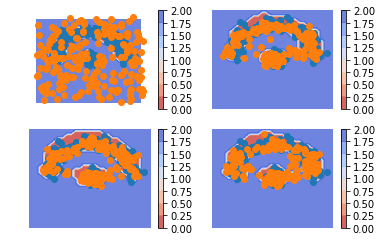

iteration  353
0.053737164 0.017163523 0.8000262 -0.76345253


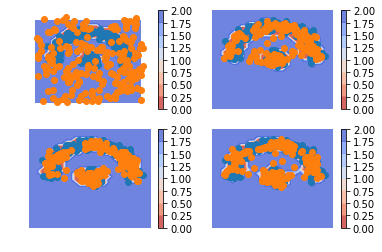

iteration  354
0.028918922 0.01753885 0.7821553 -0.7707752


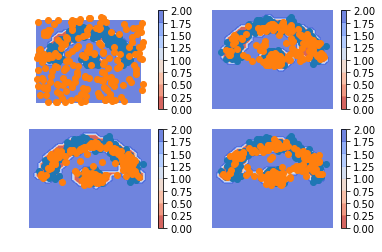

iteration  355
0.071118414 0.016469194 0.82235587 -0.76770663


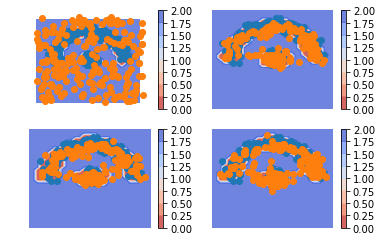

iteration  356
0.054348588 0.015387384 0.8247173 -0.78575605


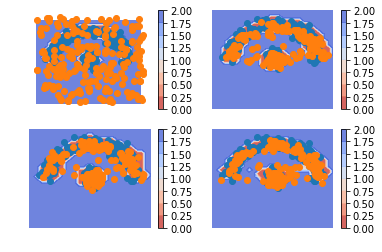

iteration  357
0.02842325 0.0138677405 0.7668075 -0.752252


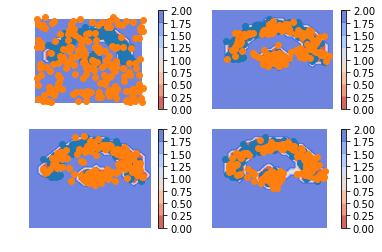

iteration  358
-0.045445085 0.01189689 0.7693906 -0.8267326


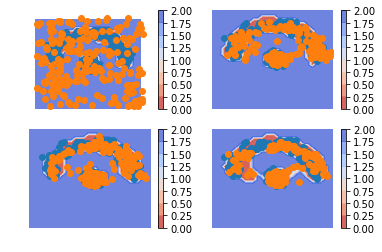

iteration  359
0.066542685 0.00976216 0.83901036 -0.78222984


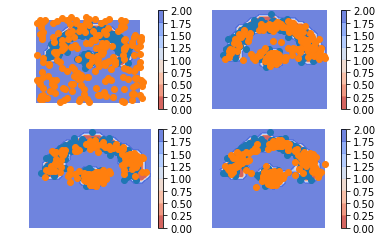

iteration  360
-0.027311206 0.007921497 0.77707577 -0.8123085


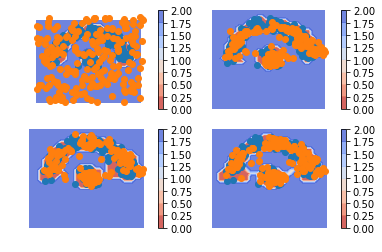

iteration  361
0.009995103 0.006468536 0.8453069 -0.8417803


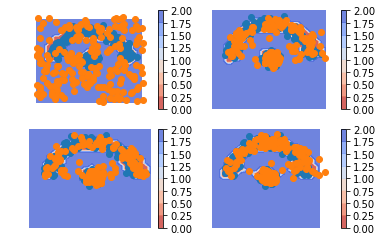

iteration  362
-0.0025402904 0.0054216594 0.772362 -0.7803239


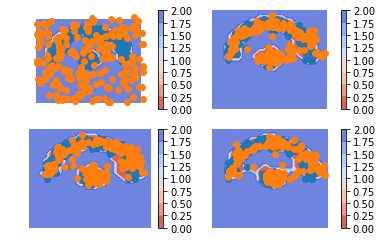

iteration  363
0.04696405 0.0047556683 0.838462 -0.7962536


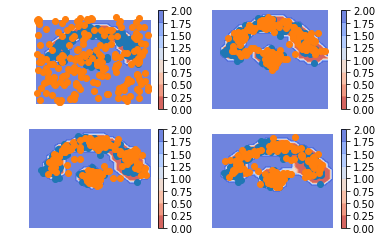

iteration  364
-0.013337374 0.003990421 0.8511953 -0.86852306


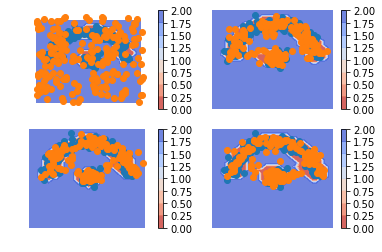

iteration  365
-0.09572303 0.003654133 0.7581858 -0.85756296


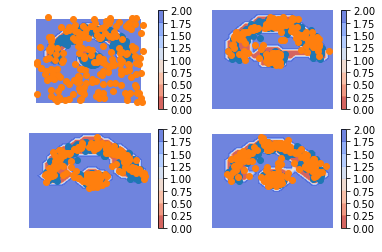

iteration  366
-0.01644671 0.0041313483 0.822199 -0.8427771


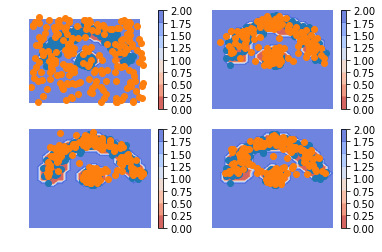

iteration  367
-0.035514176 0.0053176074 0.78658223 -0.82741404


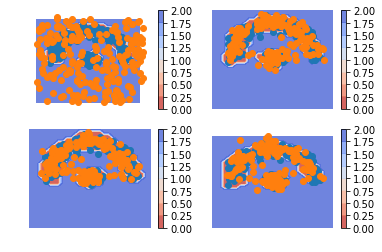

iteration  368
-0.06792945 0.0069987997 0.8054263 -0.8803545


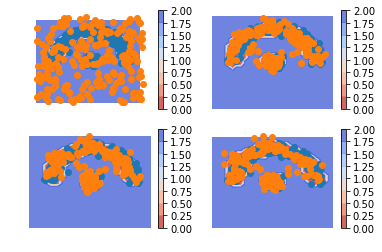

iteration  369
0.07817298 0.009163385 0.82411695 -0.75510734


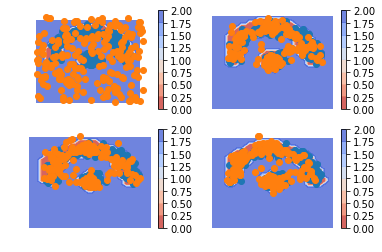

iteration  370
0.008946598 0.011337393 0.7667345 -0.7691253


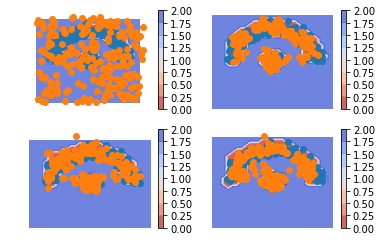

iteration  371
0.08437735 0.0131469015 0.8103386 -0.73910815


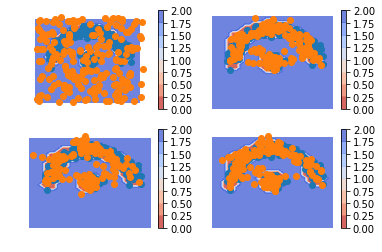

iteration  372
0.0953995 0.014362332 0.8362513 -0.75521415


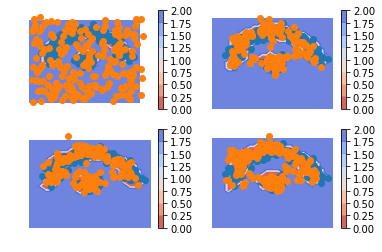

iteration  373
0.019363463 0.015006063 0.77848905 -0.77413166


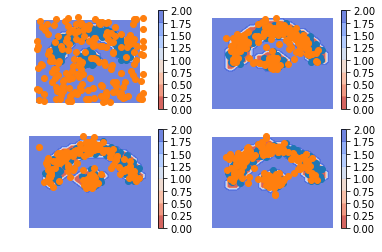

iteration  374
0.02668184 0.014883831 0.83108735 -0.8192893


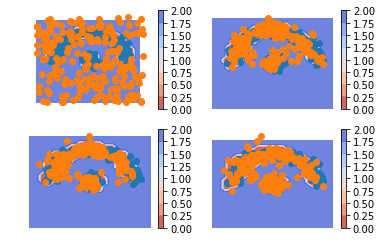

iteration  375
0.0184744 0.013984114 0.7878073 -0.783317


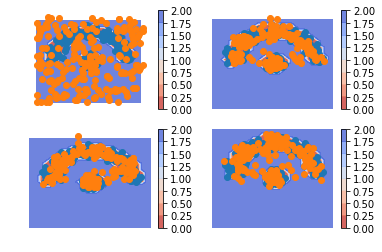

iteration  376
7.1167946e-05 0.012898163 0.77730453 -0.7901315


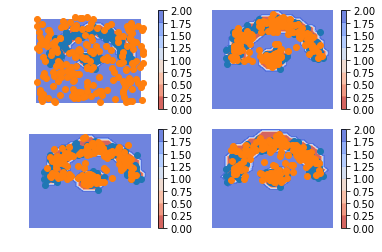

iteration  377
-0.048716128 0.011831221 0.7910508 -0.85159814


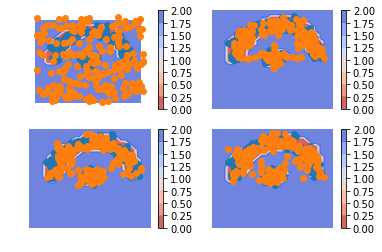

iteration  378
0.028026044 0.0102901105 0.80903304 -0.7912971


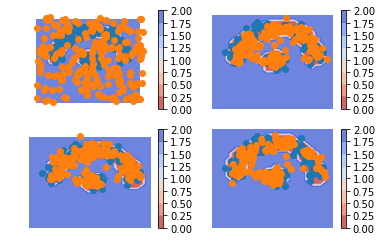

iteration  379
-0.016815662 0.008793707 0.77496123 -0.8005706


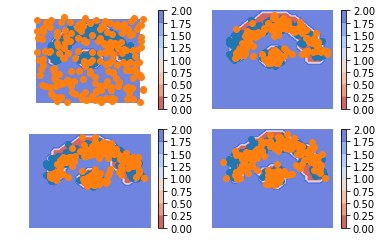

iteration  380
0.0038436055 0.0069641024 0.7973001 -0.8004206


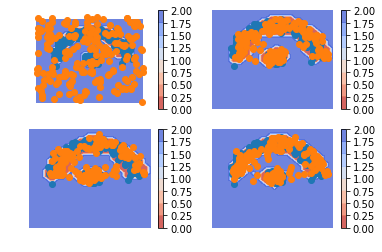

iteration  381
-0.0034837127 0.0058008637 0.79811203 -0.8073966


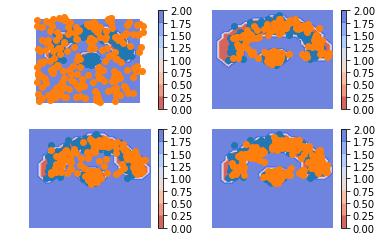

iteration  382
0.017548978 0.004768743 0.80780876 -0.7950285


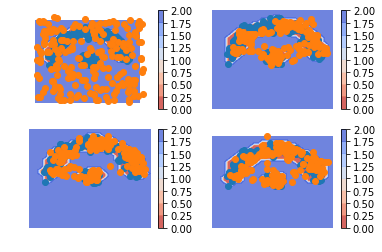

iteration  383
0.040110648 0.0038296215 0.83596706 -0.799686


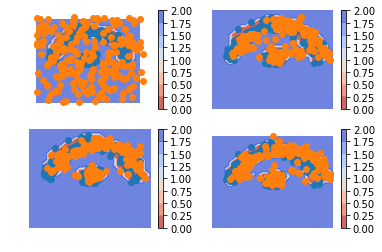

iteration  384
-0.020439804 0.0032366237 0.81942916 -0.8431056


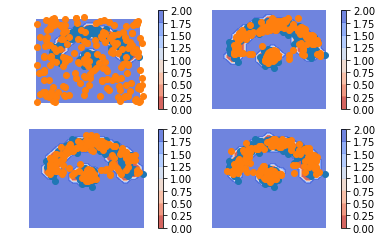

iteration  385
-0.031279087 0.0031486175 0.80264544 -0.83707315


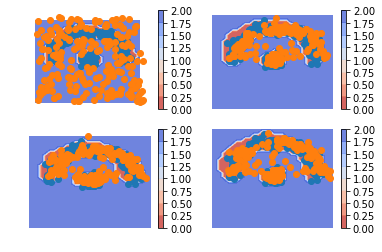

iteration  386
-0.10608631 0.0034474412 0.8045335 -0.9140672


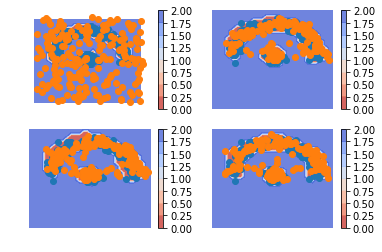

iteration  387
-0.0048678517 0.0039923787 0.7879719 -0.79683214


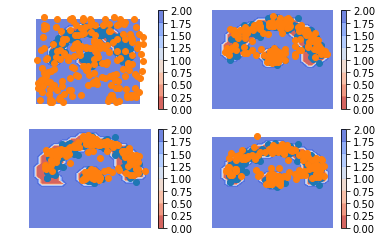

iteration  388
0.049605846 0.0048873755 0.8270144 -0.78229594


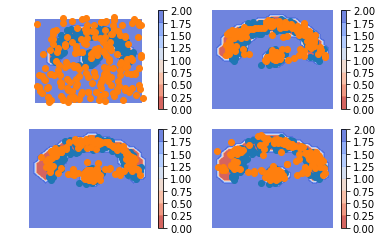

iteration  389
0.019573092 0.005592758 0.8317585 -0.81777817


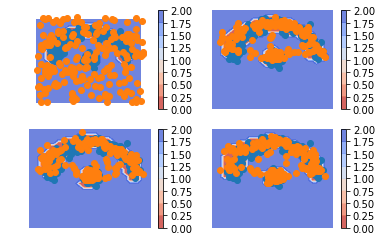

iteration  390
-0.056286573 0.0061619133 0.7662761 -0.8287246


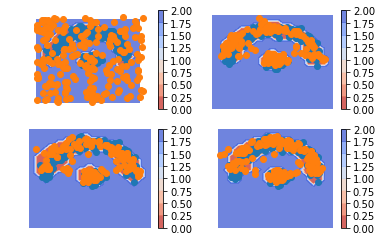

iteration  391
0.035138667 0.006028129 0.81633306 -0.7872225


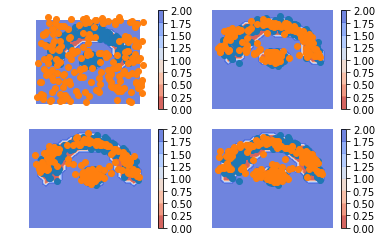

iteration  392
0.00062179565 0.0049968217 0.81144094 -0.815816


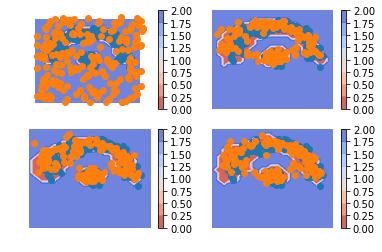

iteration  393
-0.014559865 0.0040749786 0.817217 -0.83585185


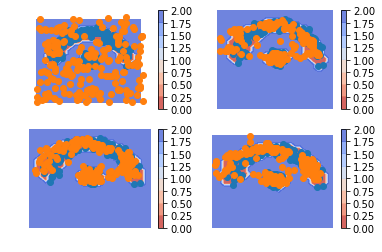

iteration  394
-0.035990417 0.0036070847 0.7975661 -0.8371636


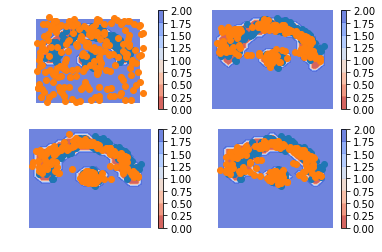

iteration  395
0.0075423717 0.0041037514 0.81430846 -0.8108699


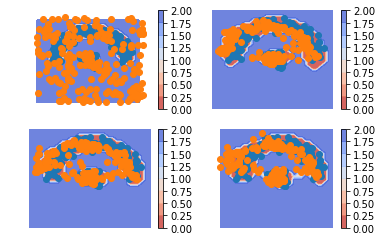

iteration  396
0.057620883 0.0043489016 0.80327535 -0.75000334


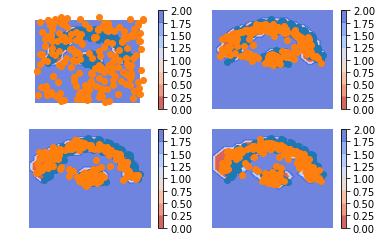

iteration  397
0.068966866 0.0042460146 0.836101 -0.7713801


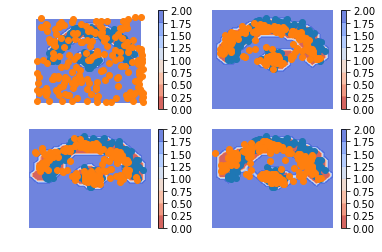

iteration  398
0.0068406463 0.0041577993 0.8150981 -0.81241524


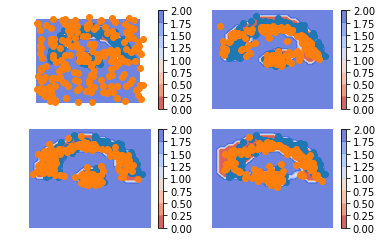

iteration  399
0.02061981 0.004003876 0.81192577 -0.79530984


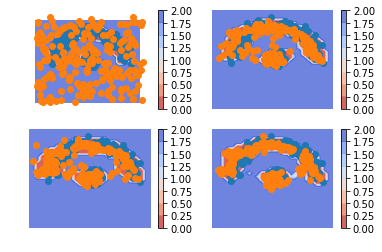

iteration  400
0.0065561533 0.0033737118 0.769874 -0.7666915


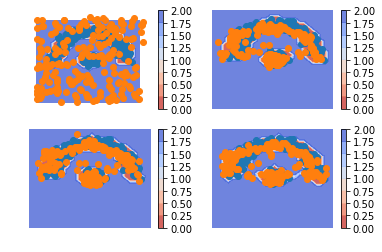

iteration  401
-0.058717668 0.0030312524 0.79424095 -0.8559899


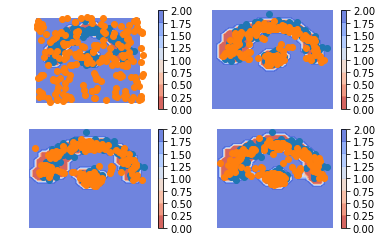

iteration  402
-0.13432467 0.0031152393 0.8088987 -0.9463386


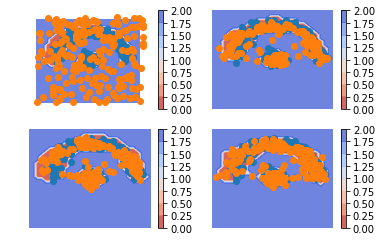

iteration  403
-0.025102973 0.0036856448 0.7789686 -0.8077572


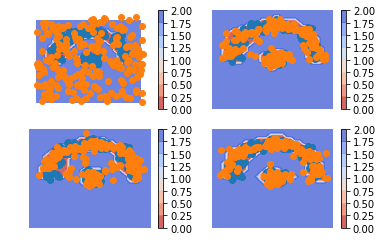

iteration  404
0.03703755 0.003949826 0.8120948 -0.7790071


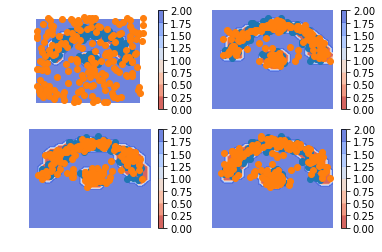

iteration  405
0.036610126 0.0039932146 0.80888665 -0.77626973


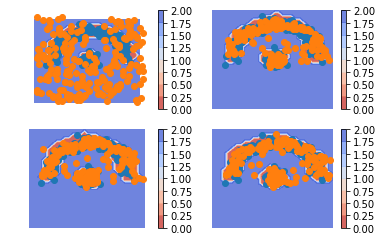

iteration  406
0.035015464 0.004187934 0.7929283 -0.76210076


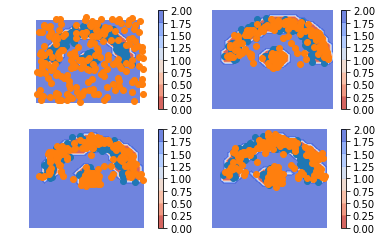

iteration  407
0.09580988 0.004301564 0.81305134 -0.721543


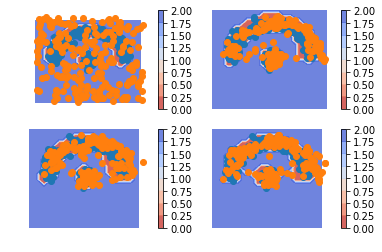

iteration  408
0.12443942 0.0044347863 0.8118541 -0.69184947


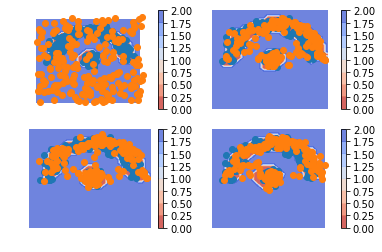

iteration  409
0.007524729 0.0046755783 0.8260822 -0.82323307


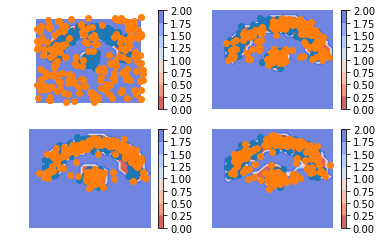

iteration  410
0.007004082 0.0045397333 0.7993821 -0.79691774


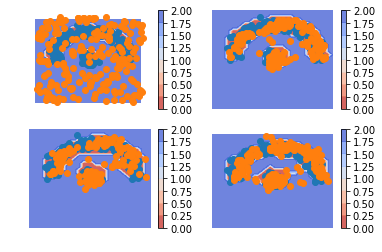

iteration  411
-0.025433958 0.0042919917 0.8279357 -0.85766166


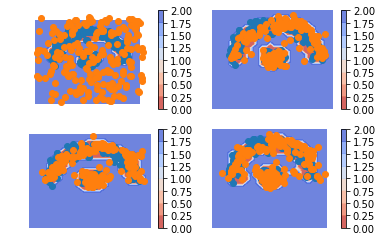

iteration  412
-0.106241524 0.0040139216 0.7639956 -0.874251


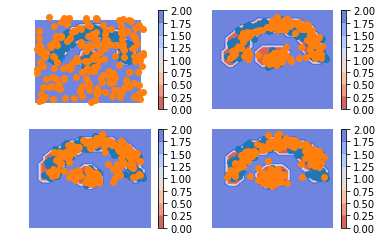

iteration  413
-0.06987411 0.0036249033 0.8014021 -0.8749011


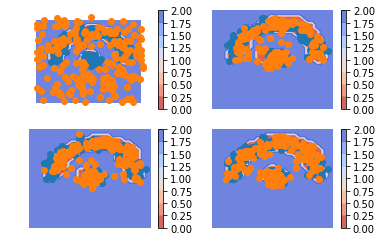

iteration  414
-0.028830528 0.003522518 0.80375123 -0.8361043


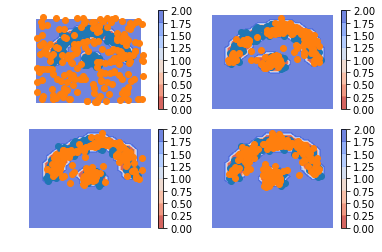

iteration  415
-0.010872185 0.003437122 0.77149427 -0.78580356


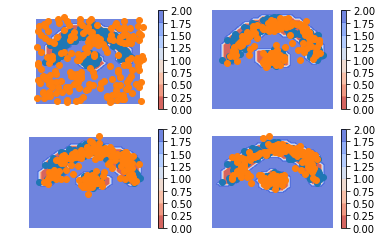

iteration  416
-0.043238223 0.0036840471 0.7900145 -0.8369368


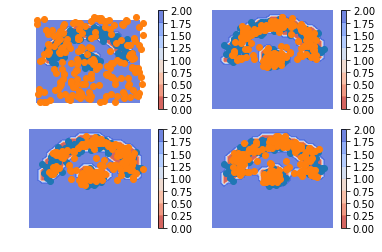

iteration  417
0.019150794 0.00414359 0.8137495 -0.7987423


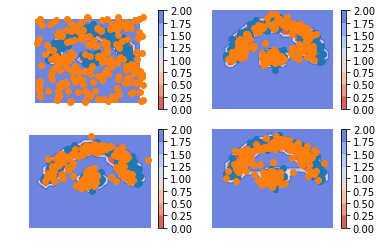

iteration  418
-0.041053593 0.004383467 0.76231694 -0.807754


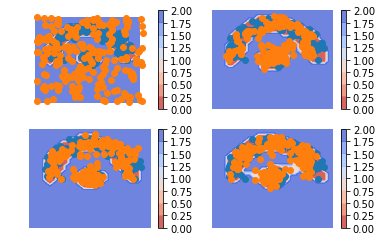

iteration  419
0.0076984763 0.0050065126 0.8163804 -0.8136884


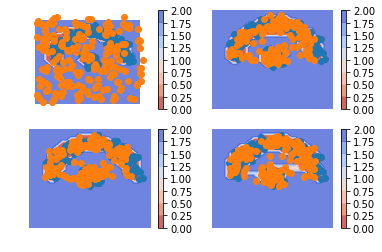

iteration  420
0.005681753 0.0064218156 0.7976034 -0.7983435


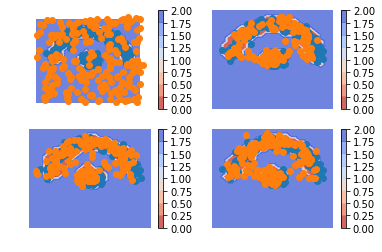

iteration  421
0.00035715103 0.0073023573 0.7801658 -0.787111


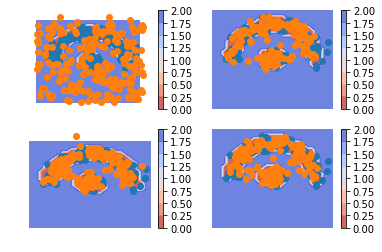

iteration  422
0.0034875274 0.008102375 0.8058771 -0.8104919


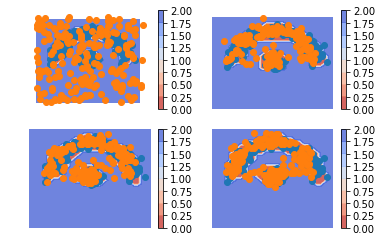

iteration  423
0.029124796 0.00937258 0.77643037 -0.75667816


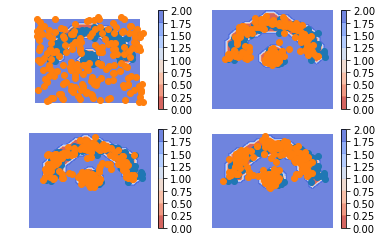

iteration  424
0.032906055 0.010015951 0.78699565 -0.76410556


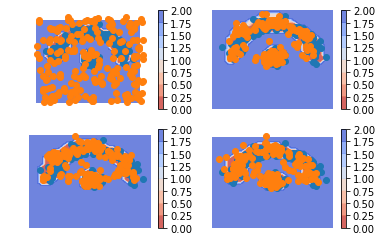

iteration  425
0.11994982 0.0102013415 0.7846192 -0.6748707


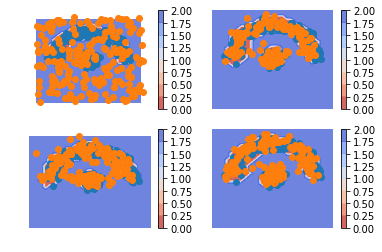

iteration  426
-0.017914355 0.010551873 0.8330439 -0.8615101


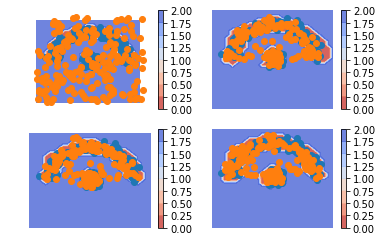

iteration  427
-0.0114225745 0.010175065 0.7728442 -0.7944418


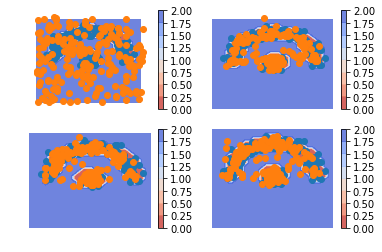

iteration  428
-0.06761223 0.009954682 0.8091125 -0.8866794


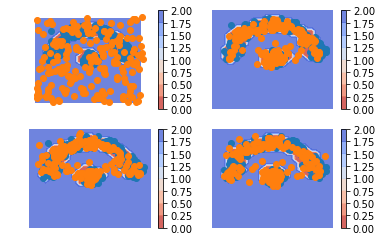

iteration  429
-0.012273192 0.009253076 0.81018263 -0.8317089


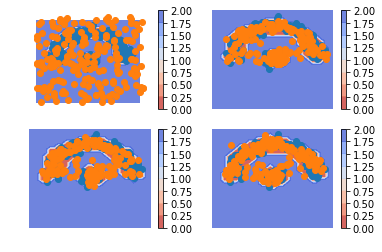

iteration  430
0.025851905 0.009101825 0.8249829 -0.8082328


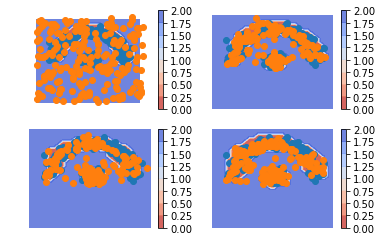

iteration  431
0.01949805 0.008896205 0.80698484 -0.796383


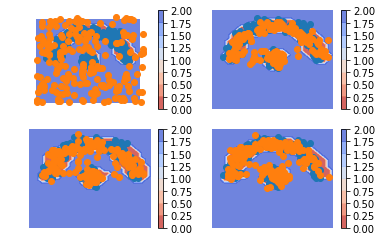

iteration  432
-0.070451796 0.008469677 0.7992735 -0.878195


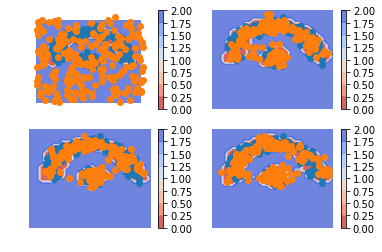

iteration  433
-0.049455702 0.008424279 0.7996123 -0.85749227


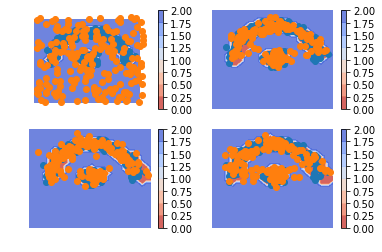

iteration  434
-0.014656663 0.008141319 0.8168292 -0.8396272


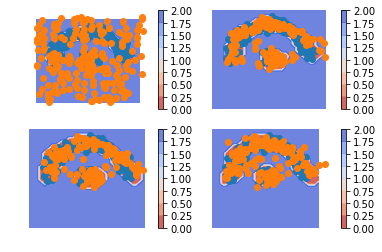

iteration  435
-0.012957573 0.008165769 0.82142186 -0.8425452


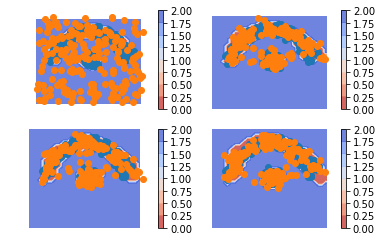

iteration  436
0.03783554 0.007874644 0.832658 -0.8026971


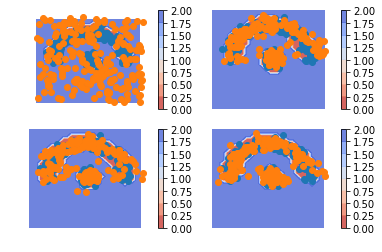

iteration  437
0.045917273 0.007710954 0.82878566 -0.7905793


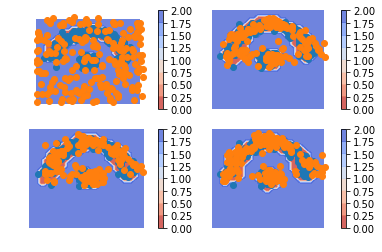

iteration  438
0.03751713 0.007525579 0.81107783 -0.78108627


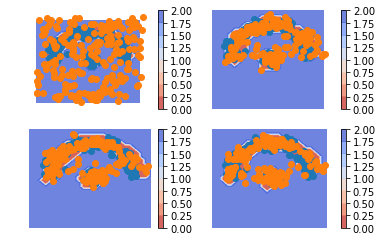

iteration  439
0.04384941 0.006977919 0.8212352 -0.7843637


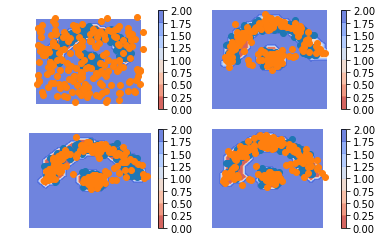

iteration  440
0.31423262 0.0067311325 0.80254424 -0.49504277


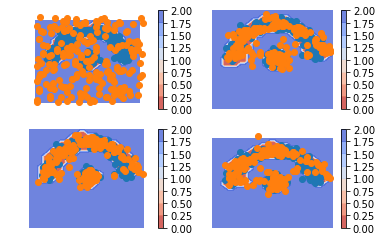

iteration  441
-0.06908637 0.0064701377 0.791144 -0.86670053


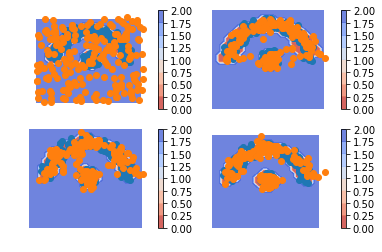

iteration  442
0.0046699047 0.0056357197 0.81479156 -0.8157574


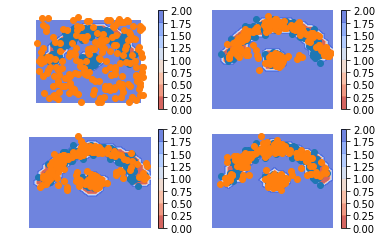

iteration  443
-0.092755556 0.005123415 0.8277233 -0.9256023


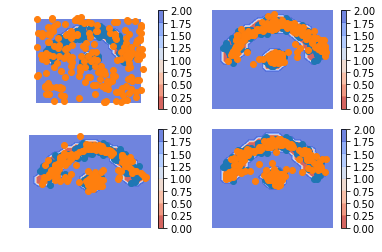

iteration  444
-0.05018556 0.0046007824 0.7818086 -0.83659494


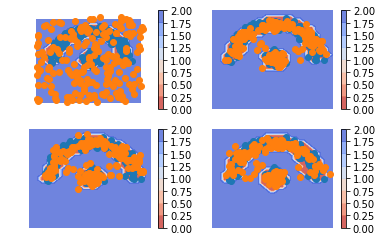

iteration  445
-0.040638804 0.003989304 0.82441807 -0.86904615


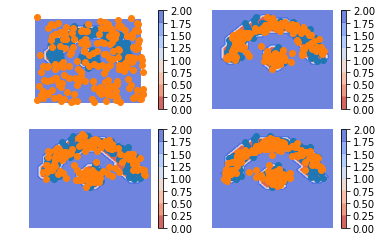

iteration  446
-0.021936 0.0033262658 0.8285862 -0.85384846


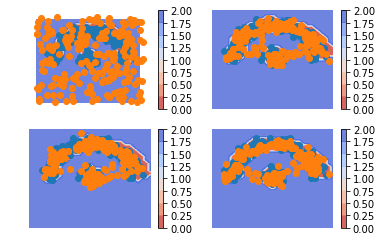

iteration  447
-0.03233236 0.0027922413 0.8359211 -0.8710457


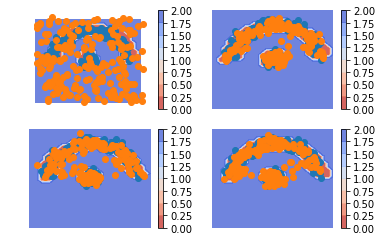

iteration  448
-0.045484185 0.0023676904 0.8106649 -0.85851675


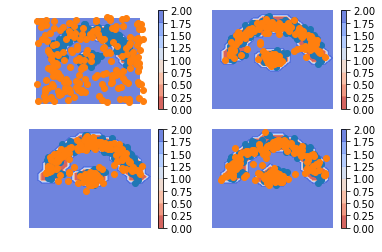

iteration  449
-0.030994713 0.0022675332 0.79476595 -0.8280282


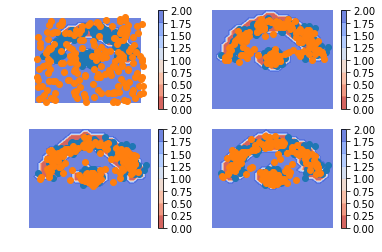

iteration  450
-0.07966155 0.0021554127 0.8234395 -0.90525645


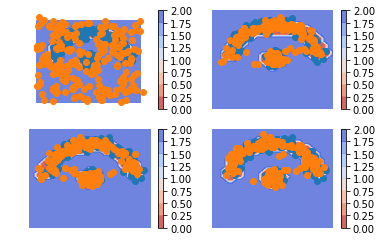

iteration  451
-0.027541876 0.0020975121 0.8133657 -0.84300506


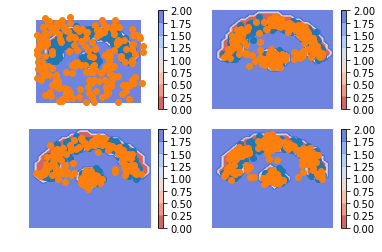

iteration  452
0.047507703 0.0020333328 0.8531978 -0.80772346


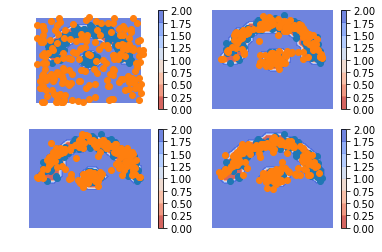

iteration  453
0.023984015 0.001949906 0.8166859 -0.7946518


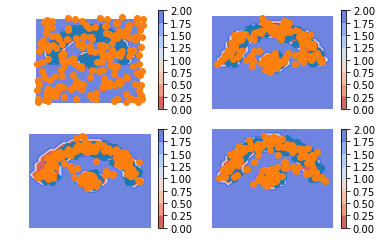

iteration  454
-0.042419255 0.0019240121 0.82143766 -0.86578095


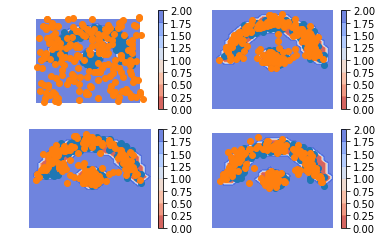

iteration  455
-0.06526232 0.0019591288 0.7924289 -0.8596504


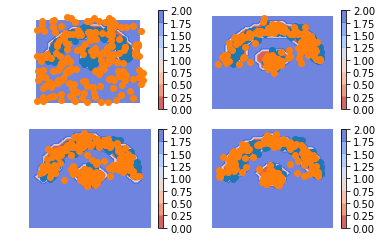

iteration  456
-0.027128816 0.00212208 0.8083715 -0.8376224


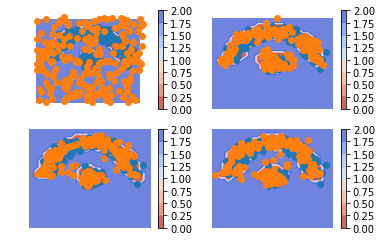

iteration  457
-0.0033383965 0.0023923274 0.831156 -0.83688676


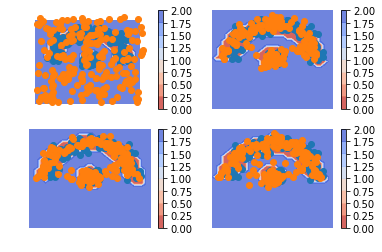

iteration  458
-0.012604415 0.0026436755 0.81494224 -0.83019036


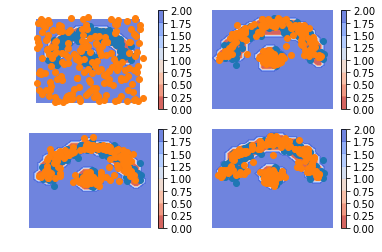

iteration  459
-0.058870673 0.0026286948 0.7872967 -0.84879607


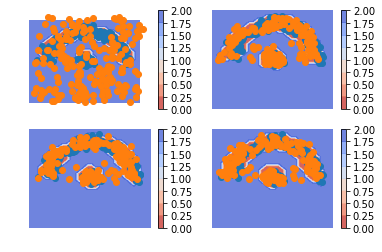

iteration  460
0.024731457 0.0025302542 0.7869396 -0.76473844


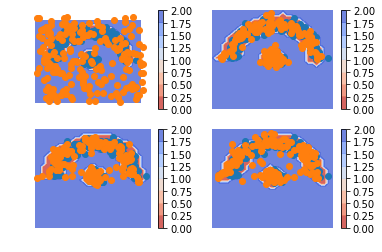

iteration  461
0.04334557 0.0025261869 0.83135307 -0.79053366


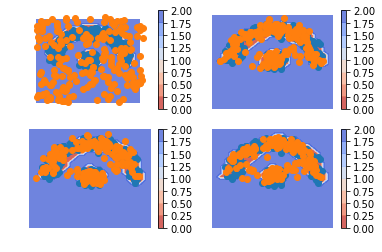

iteration  462
-0.013440073 0.003026037 0.7863505 -0.80281657


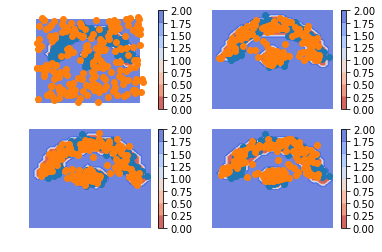

iteration  463
-0.037407875 0.0033903543 0.8194066 -0.8602049


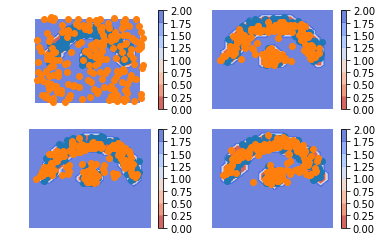

iteration  464
-0.030257821 0.0037351989 0.8207119 -0.8547049


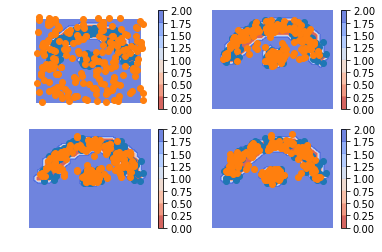

iteration  465
0.0032199025 0.0037602736 0.7941896 -0.79472995


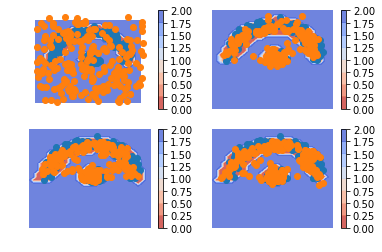

iteration  466
0.17274469 0.003843596 0.8102472 -0.6413461


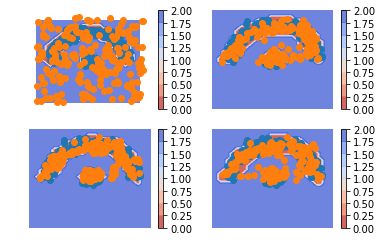

iteration  467
-0.02878946 0.003741441 0.7769306 -0.8094615


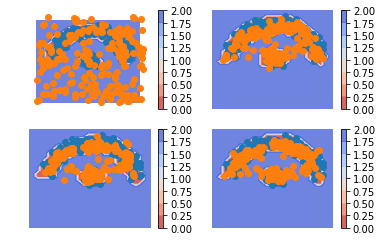

iteration  468
-0.04674816 0.0035977971 0.7529196 -0.8032656


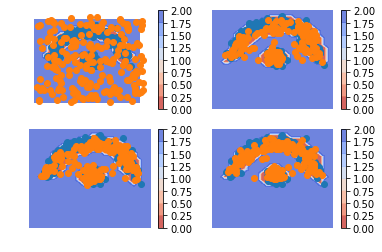

iteration  469
-0.03822249 0.0034576424 0.7895982 -0.8312784


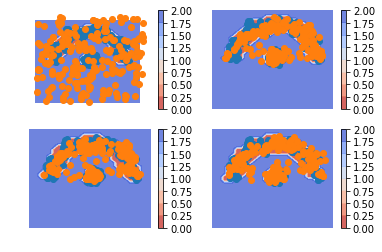

iteration  470
-0.0049054027 0.0036375078 0.80327606 -0.81181896


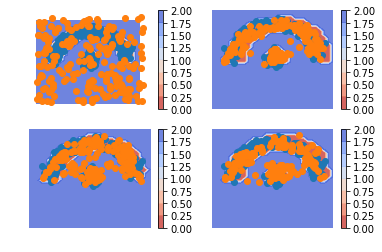

iteration  471
-0.036545515 0.0039457767 0.7941674 -0.8346587


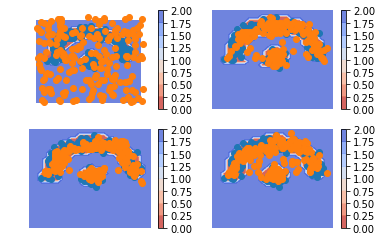

iteration  472
-0.05013603 0.0043244837 0.82013094 -0.87459147


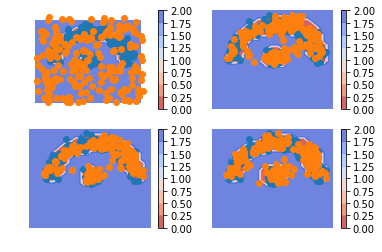

iteration  473
-0.029721975 0.004436096 0.80540115 -0.8395592


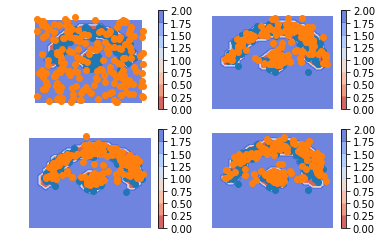

iteration  474
-0.052176654 0.004403328 0.79372 -0.8503


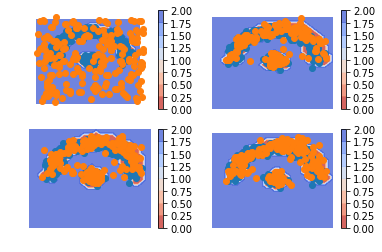

iteration  475
-0.0057414174 0.0042780377 0.8191422 -0.8291617


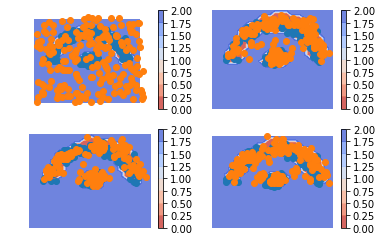

iteration  476
0.028558314 0.0041691903 0.7929215 -0.76853234


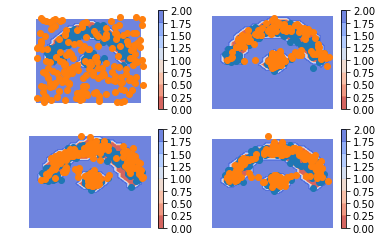

iteration  477
-0.0044146776 0.0040487633 0.799637 -0.80810046


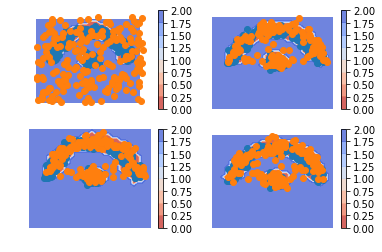

iteration  478
-0.0587368 0.004207503 0.79226017 -0.85520446


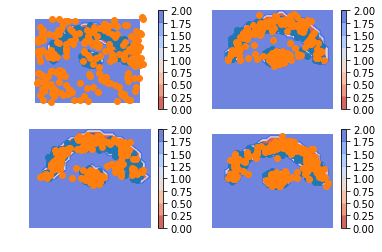

iteration  479
-0.0092564225 0.004390739 0.8226741 -0.83632123


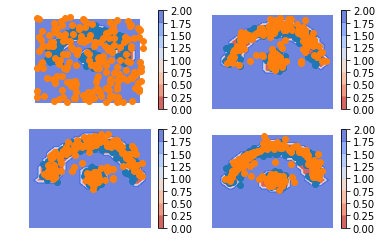

iteration  480
0.023181915 0.0047835745 0.80099154 -0.7825932


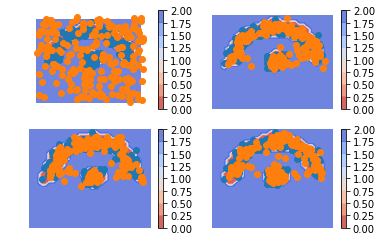

iteration  481
0.114411116 0.005262753 0.7883819 -0.6792335


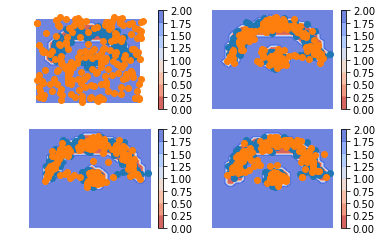

iteration  482
0.2121824 0.005825868 0.84892124 -0.6425647


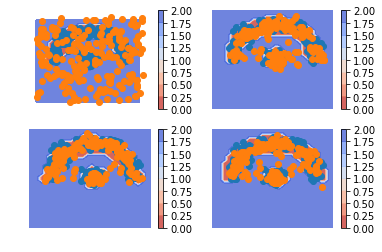

iteration  483
0.0044445395 0.006511168 0.8092136 -0.8112802


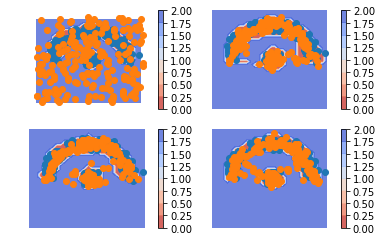

iteration  484
-0.015597105 0.0074511394 0.841863 -0.8649112


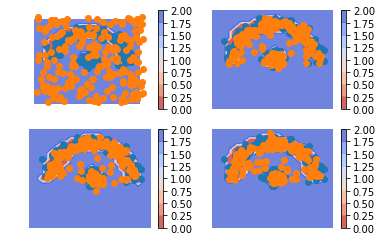

iteration  485
0.0320518 0.008883266 0.81462765 -0.7914591


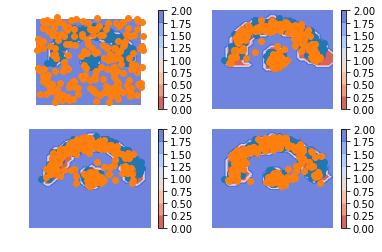

iteration  486
-0.04412192 0.0104270745 0.7731659 -0.82771486


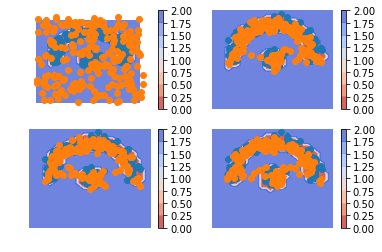

iteration  487
0.003971815 0.012193272 0.8200367 -0.82825816


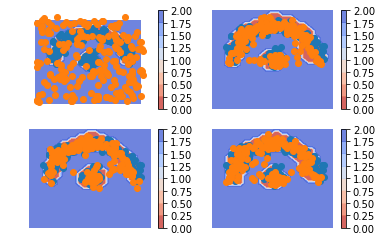

iteration  488
-0.039758265 0.013142485 0.7838155 -0.83671623


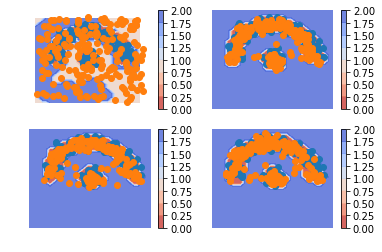

iteration  489
0.361173 0.013895952 0.82051647 -0.4732394


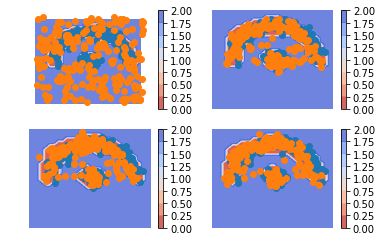

iteration  490
0.04415071 0.013944656 0.82770866 -0.79750264


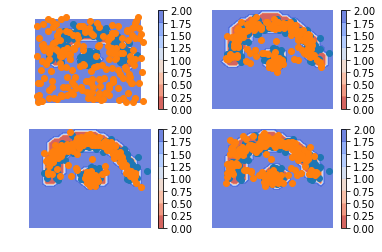

iteration  491
0.023506403 0.013862482 0.82166946 -0.81202555


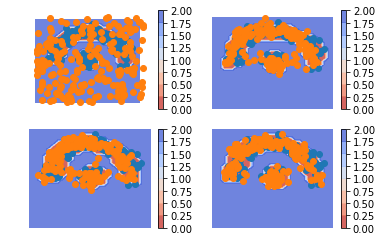

iteration  492
-0.026082814 0.0135237565 0.8020279 -0.84163445


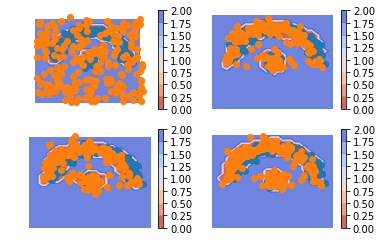

iteration  493
0.026158512 0.012902827 0.8198199 -0.8065643


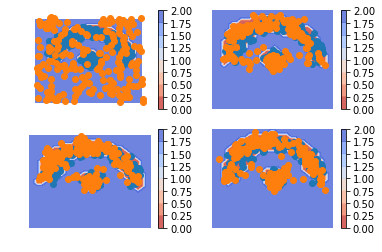

iteration  494
-0.0342986 0.012366688 0.8162693 -0.8629346


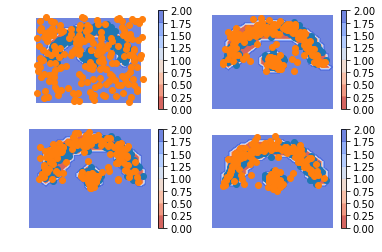

iteration  495
0.023371816 0.012286517 0.80389464 -0.79280937


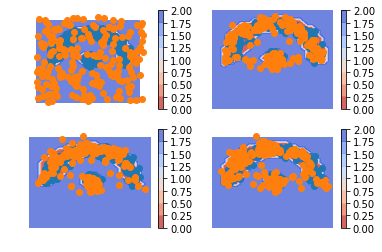

iteration  496
-0.010391474 0.012109126 0.80816144 -0.830662


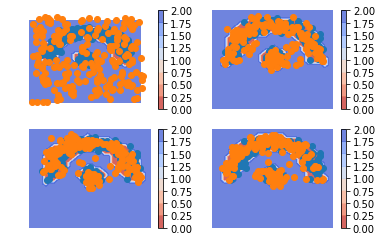

iteration  497
-0.065942764 0.011674525 0.79245675 -0.87007403


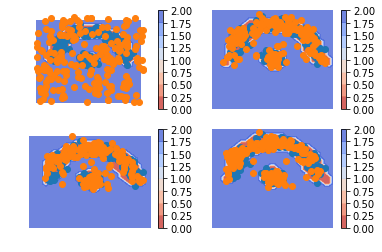

iteration  498
-0.05267918 0.010887259 0.7983185 -0.86188495


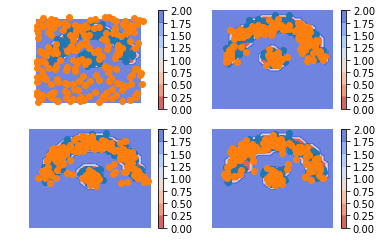

iteration  499
-0.049773097 0.00930239 0.81354743 -0.8726229


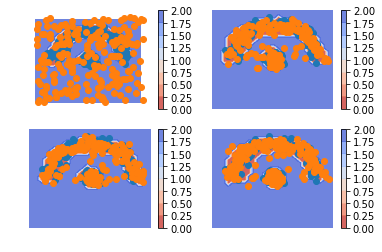

In [11]:
saver=tf.train.Saver()
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    for i in range(500):
        print('iteration ',i)
        X_true=make_toy_dataset_old(200,0.1)
        X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
        X_noise=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
        image=np.vstack((X_true,X_fake,X_noise))
        label=np.concatenate((np.zeros(200),np.ones(200),2*np.ones(200)))
        loss_num,l1,l2,l3,i_his=sess.run([tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,image_his],feed_dict={X:image,y:label})
        for t in range(10):
            _=sess.run([train_step1],feed_dict={X:image,y:label})
        _=sess.run([train_step2],feed_dict={X:image,y:label})
        print(loss_num,l1,l2,l3)
#         print(label)
#         print([(a.reshape(-1,)>0.5).astype(dtype=np.int32) for a in p_his])
        display(i_his,i)
        save_path = saver.save(sess, "parameters/toy/toy.ckpt")

In [12]:
'''
**************************************************************************************************************
There is a problem with classifier. 
Saparate classifier behave well, but in model it fails
**************************************************************************************************************
'''
# t=1
# plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
# plt.scatter(i_his[t][200:,0],i_his[t][200:,1])
# plt.show()

# # n_out1=tf.layers.dense(X,units=100,activation=tf.nn.relu)
# # n_score=tf.layers.dense(n_out1,units=1)

# with tf.variable_scope("temp_scope") as vs:
#     classifier=Classifier()
#     n_score,prob,predict=classifier(X)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
    
#     h=0.1
#     xx, yy = np.meshgrid(
#         np.arange(-1.5, 1.5, h),
#         np.arange(-1.5, 1.5, h))
#     points=np.c_[xx.ravel(), yy.ravel()]

#     Z=sess.run(n_score,feed_dict={X:points})
#     Z=Z.reshape(xx.shape)
#     _=plt.contourf(xx,yy,Z,cmap=plt.cm.coolwarm_r, alpha=0.8)
#     plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
#     plt.scatter(i_his[t][200:,0],i_his[t][200:,1])
#     plt.axis('off')
#     plt.colorbar(_)
#     plt.show()
    

'\n**************************************************************************************************************\nThere is a problem with classifier. \nSaparate classifier behave well, but in model it fails\n**************************************************************************************************************\n'

In [13]:
a=tf.constant([[0],[1]])
b=tf.constant([[1],[2]])
d=[a,b]
c=tf.reduce_sum(d,axis=0)

with tf.Session() as sess:
    print(sess.run(d))
    print(sess.run(c))

[array([[0],
       [1]], dtype=int32), array([[1],
       [2]], dtype=int32)]
[[1]
 [3]]


INFO:tensorflow:Restoring parameters from parameters/toy/toy.ckpt


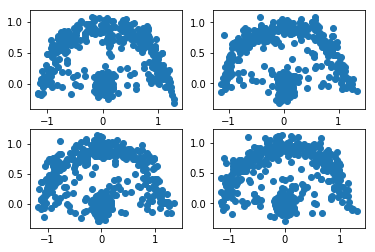

In [14]:
G_batch_size=tf.placeholder(shape=(),dtype=tf.int32,name='batch_size')
G_state_decode=vae.decoder_lstm.zero_state(G_batch_size, tf.float32)
G_unit_gaussian=tf.distributions.Normal(loc=tf.zeros((G_batch_size,vae.latent_dim)),scale=tf.ones((G_batch_size,vae.latent_dim)))

G_output_his=[]

for t in range(vae.n_time):
    G_Z=G_unit_gaussian.sample()
    with tf.variable_scope("LSTM_decoder") as vs:
        G_decode_out,G_state_decode=vae.decoder_lstm(G_Z,G_state_decode)
    G_output_image=vae.emit_net(G_decode_out)
    G_output_his.append(G_output_image)
    
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    saver.restore(sess, "parameters/toy/toy.ckpt")
    output=sess.run(G_output_his,feed_dict={G_batch_size:500})
    plt.figure(1)
    for i in range(4):
        plt.subplot(2,2,i+1)
        plt.scatter(output[i][:,0],output[i][:,1])
    plt.show()